### **Percobaan Klasifikasi dan Sortir Biji Kopi Peaberry, Longberry, Premium dan Defect dengan Menggunakan Deep Learning.**

# **DATA**

## **Membaca dan mengakses data dari Google Drive**

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## **Mengimpor package yang diperlukan**

In [1]:
import numpy as np
import torch
import torchvision
from torchvision import datasets, models, transforms
import torch.utils.data as data
from torch.utils.tensorboard import SummaryWriter
import torch.nn as nn
import torch.optim as optim
from torch.optim import lr_scheduler
import time, os, copy, argparse
import multiprocessing
from torchsummary import summary
from matplotlib import pyplot as plt
from PIL import Image

ModuleNotFoundError: No module named 'torch'

In [ ]:
!pip install torchvision

## **Launch kode program dengan environment variabel CUDA_LAUNCH_BLOCKING**

In [ ]:
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = "1"

## **Membuat variabel train, validasi dan test dari path direktori di Google Drive**

In [ ]:
# buat variabel train, validasi dan test dari path dataset
train_dir = '/content/drive/MyDrive/CFStar-Tech-800-2021/train'

val_dir = '/content/drive/MyDrive/CFStar-Tech-800-2021/val'

test_dir = '/content/drive/MyDrive/CFStar-Tech-800-2021/test'


## **Membuat variabel awal untuk percobaan**

In [ ]:
# Membuat variabel untuk banyak epoch
num_epochs = 25

# Membuat variabel untuk batch size
batch_size = 4

# variabel untuk jumlah kelas percobaan
num_classes = 4

# variabel untuk num_workers dimana memberitahukan berapa banyak sub-proses yang digunakan untuk memuat data
num_cpu = multiprocessing.cpu_count()

## **Menghitung nilai rata-rata (mean) dan standar deviasi (std) untuk dilakukan normalisasi gambar**

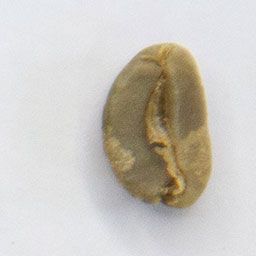

In [ ]:
# load dan menampilkan contoh gambar biji kopi yang akan dihitung

# Memuat gambar
path_base ='/content/drive/MyDrive/CFStar-Tech-800-2021/train'
img_path = path_base + '/longberry/1010.jpg'
img = Image.open(img_path)
img

Text(0.5, 1.0, 'distribusi dari setiap pixel')

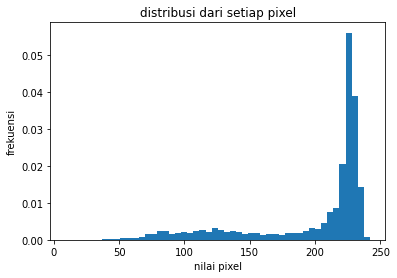

In [ ]:
# Mengonversi gambar PIL ke numpy array
img_np = np.array(img)


# Membuat plot nilai setiap pixel gambar
plt.hist(img_np.ravel(), bins=50, density=True)
plt.xlabel("nilai pixel")
plt.ylabel("frekuensi")
plt.title("distribusi dari setiap pixel")

Text(0.5, 1.0, 'distribusi dari setiap pixel')

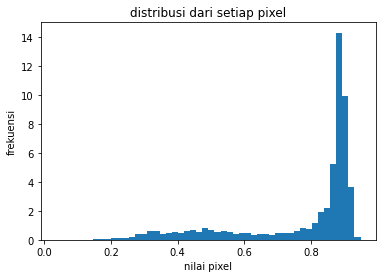

In [ ]:
# membuat tansforms gambar ke Pytorch tensor
transform = transforms.Compose([
    transforms.ToTensor()
])

# melakukan transform dari gambar PIL ke tensor
img_tr = transform(img)

# mengonversi gambar tensor ke numpy array
img_np = np.array(img_tr)

# Membuat plot nilai setiap pixel gambar
plt.hist(img_np.ravel(), bins=50, density=True)
plt.xlabel("nilai pixel")
plt.ylabel("frekuensi")
plt.title("distribusi dari setiap pixel")

In [ ]:
# menghitung nilai rata-rata (mean) dan standar deviasi (std)

# Gambar tensor
img_tr = transform(img)

# Menghitung mean dan std
mean, std = img_tr.mean([1,2]), img_tr.std([1,2])

# mencetak hasil kalkulasi
print("nilai rata-rata (mean) dan standar deviasi (std) sebelum normalisasi:")
print("rata-rata (mean) dari gambar      :", mean)
print("standar deviasi (std) dari gambar :", std)

nilai rata-rata (mean) dan standar deviasi (std) sebelum normalisasi:
rata-rata (mean) dari gambar      : tensor([0.7980, 0.7820, 0.7562])
standar deviasi (std) dari gambar : tensor([0.1441, 0.1729, 0.2341])


Text(0.5, 1.0, 'distribusi dari setiap pixel')

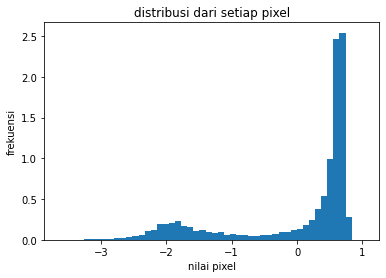

In [ ]:
# membandingkan nilai sebelum normalisasi dengan setelah normalisasi

# membuat tansforms gambar ke Pytorch tensor dan normalisasi dari nilai mean dan std
transform_norm = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize(mean, std)
])

# gambar yang akan dinormalisasi
img_normalized = transform_norm(img)

# mengkonversi gambar normalisasi ke numpy array
img_np = np.array(img_normalized)

# Membuat plot nilai setiap pixel gambar
plt.hist(img_np.ravel(), bins=50, density=True)
plt.xlabel("nilai pixel")
plt.ylabel("frekuensi")
plt.title("distribusi dari setiap pixel")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


([], <a list of 0 Text major ticklabel objects>)

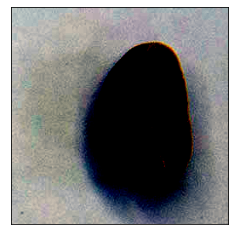

In [ ]:
# Menampilkan hasil gambar normalisasi

img_normalized = transform_norm(img)

# mengkonversi gambar ke numpy array
img_normalized = np.array(img_normalized)

# transpose dari shape (3,,) ke shape (,,3)
img_normalized = img_normalized.transpose(1, 2, 0)

# menampilkan hasil gambar normalisasi
plt.imshow(img_normalized)
plt.xticks([])
plt.yticks([])

In [ ]:
# menghitung nilai mean dan std setelah normalisasi dimana nilai mean yaitu 0.0 dan nilai std yaitu 1.0

# gambar yang sudah dinormalisasi
img_nor = transform_norm(img)

# menghitung nilai rata-rata dan standar deviasi
mean, std = img_nor.mean([1,2]), img_nor.std([1,2])

# mencetak hasil nilai rata-rata dan standar deviasi
print("nilai rata-rata dan standar deviasi dari normalisasi gambar:")
print("nilai rata-rata dari gambar        :", mean)
print("nilai standar deviasi dari gambar  :", std)

nilai rata-rata dan standar deviasi dari normalisasi gambar:
nilai rata-rata dari gambar        : tensor([ 2.1583e-07,  7.3912e-07, -1.3178e-07])
nilai standar deviasi dari gambar  : tensor([1., 1., 1.])


## **Membuat Data Transform**

In [ ]:
# membuat variabel nilai rata-rata (mean) dan standar deviasi (std) untuk digunakan dalam normalisasi gambar
mean = [0.7980, 0.7820, 0.7562]
std = [0.1441, 0.1729, 0.2341]

In [ ]:
# Membuat transform data gambar agar cocok saat dilatih
image_transforms = {
    'train': transforms.Compose([
                                 transforms.Resize(size=(256, 256)),
                                 transforms.RandomHorizontalFlip(),
                                 transforms.ToTensor(),
                                 transforms.Normalize(mean, std)
                                 ]),
    'val': transforms.Compose([
                               transforms.Resize(size=(256, 256)),
                               transforms.ToTensor(),
                               transforms.Normalize(mean, std)
                               ]),
    'test': transforms.Compose([
                                transforms.Resize(size=(256, 256)),
                                transforms.ToTensor(),
                                transforms.Normalize(mean, std)
                                ]),
                    }

## **Ringkasan dan Visualisasi Dataset**

In [ ]:
# Memuat data dari folder
dataset = {
    'train': datasets.ImageFolder(root=train_dir, transform=image_transforms['train']),
    'val': datasets.ImageFolder(root=val_dir, transform=image_transforms['val']),
    'test': datasets.ImageFolder(root=test_dir, transform=image_transforms['test']),
}

In [ ]:
# memuat banyak kelas pada dataset
classes = dataset['train'].classes
print('banyak kelas pada dataset ini adalah', len(classes),'dan kelas pada dataset terdiri dari:', classes)

banyak kelas pada dataset ini adalah 4 dan kelas pada dataset terdiri dari: ['defect', 'longberry', 'peaberry', 'premium']


In [ ]:
# menghitung banyak data dari data latih, data validasi dan data uji
dataset_sizes = {
    'train':len(dataset['train']),
    'val':len(dataset['val']),
    'test':len(dataset['test'])
}

In [ ]:
# Mencetak banyak jumlah dataset
print("banyak data gambar pada data latih   :",dataset_sizes['train'])
print("banyak data gambar pada data validasi:", dataset_sizes['val'])
print("banyak data gambar pada data uji     :", dataset_sizes['test'])

banyak data gambar pada data latih   : 4800
banyak data gambar pada data validasi: 1600
banyak data gambar pada data uji     : 1600


In [ ]:
# membuat iterator untuk memuat dataset
dataloaders = {
    'train' : data.DataLoader(dataset['train'], batch_size=batch_size, shuffle=True, num_workers=num_cpu, pin_memory=True, drop_last=True),
    'val'   : data.DataLoader(dataset['val'], batch_size=batch_size, shuffle=True, num_workers=num_cpu, pin_memory=True, drop_last=True),
    'test'  : data.DataLoader(dataset['test'], batch_size=batch_size, shuffle=True, num_workers=num_cpu, pin_memory=True, drop_last=True)
}

print('banyak jumlah data latih per kelas adalah', len(dataloaders['train']), 'gambar')
print('banyak jumlah data validasi per kelas adalah', len(dataloaders['val']), 'gambar')
print('banyak jumlah data uji per kelas adalah', len(dataloaders['test']), 'gambar')

banyak jumlah data latih per kelas adalah 1200 gambar
banyak jumlah data validasi per kelas adalah 400 gambar
banyak jumlah data uji per kelas adalah 400 gambar


In [ ]:
# mengecek jumlah batch size, output warna dan jumlah ukuran gambar dalam bentuk pixel

images, labels = next(iter(dataloaders['train']))
print("jumlah kelas adalah", len(labels))
print("dimensi ukuran gambar adalah", images.shape)

jumlah kelas adalah 4
dimensi ukuran gambar adalah torch.Size([4, 3, 256, 256])


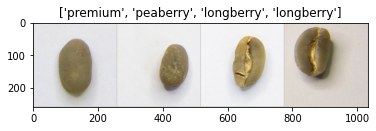

In [ ]:
# visualisasi data gambar pada dataset

def imshow(inp, title=None):
    inp = inp.numpy().transpose((1, 2, 0))
    mean = [0.7980, 0.7820, 0.7562]
    std = [0.1441, 0.1729, 0.2341]
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001) # jeda untuk memperbarui plot gambar

# Mengambil data gambar dari data latih
inputs, classes = next(iter(dataloaders['train']))
class_names = dataset['train'].classes
# membuat grid
out = torchvision.utils.make_grid(inputs)

imshow(out, title=[class_names[x] for x in classes])

#**PERCOBAAN 1**

## **Device default**

In [ ]:
# membuat device default sebagai gpu, jika ada
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
images, labels = images.to(device), labels.to(device)

## **Percobaan 1: Resnet18**

In [ ]:
# percobaan 1: menggunakan pretrained model dengan arsitektur Resnet18

print("\nmemuat resnet18 \n")
model_ft = models.resnet18(pretrained=True)

num_ftrs = model_ft.fc.in_features
model_ft.fc = nn.Linear(num_ftrs,num_classes )

# transfer model ke GPU
model_ft = model_ft.to(device)

for num, (name, param) in enumerate(model_ft.named_parameters()):
    print(num, name, param.requires_grad )

# Loss function
criterion = nn.CrossEntropyLoss()

# Optimizer
optimizer_ft = optim.SGD(model_ft.parameters(), lr=0.001, momentum=0.9)

# Learning rate
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_ft, step_size=7, gamma=0.1)


memuat resnet18 



Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth


  0%|          | 0.00/44.7M [00:00<?, ?B/s]

0 conv1.weight True
1 bn1.weight True
2 bn1.bias True
3 layer1.0.conv1.weight True
4 layer1.0.bn1.weight True
5 layer1.0.bn1.bias True
6 layer1.0.conv2.weight True
7 layer1.0.bn2.weight True
8 layer1.0.bn2.bias True
9 layer1.1.conv1.weight True
10 layer1.1.bn1.weight True
11 layer1.1.bn1.bias True
12 layer1.1.conv2.weight True
13 layer1.1.bn2.weight True
14 layer1.1.bn2.bias True
15 layer2.0.conv1.weight True
16 layer2.0.bn1.weight True
17 layer2.0.bn1.bias True
18 layer2.0.conv2.weight True
19 layer2.0.bn2.weight True
20 layer2.0.bn2.bias True
21 layer2.0.downsample.0.weight True
22 layer2.0.downsample.1.weight True
23 layer2.0.downsample.1.bias True
24 layer2.1.conv1.weight True
25 layer2.1.bn1.weight True
26 layer2.1.bn1.bias True
27 layer2.1.conv2.weight True
28 layer2.1.bn2.weight True
29 layer2.1.bn2.bias True
30 layer3.0.conv1.weight True
31 layer3.0.bn1.weight True
32 layer3.0.bn1.bias True
33 layer3.0.conv2.weight True
34 layer3.0.bn2.weight True
35 layer3.0.bn2.bias True
36 l

In [ ]:
# mencetak ringkasan model
print('Model Summary:-\n')
summary(model_ft, input_size=(3, 256, 256))
print(model_ft)

Model Summary:-

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 64, 128, 128]           9,408
       BatchNorm2d-2         [-1, 64, 128, 128]             128
              ReLU-3         [-1, 64, 128, 128]               0
         MaxPool2d-4           [-1, 64, 64, 64]               0
            Conv2d-5           [-1, 64, 64, 64]          36,864
       BatchNorm2d-6           [-1, 64, 64, 64]             128
              ReLU-7           [-1, 64, 64, 64]               0
            Conv2d-8           [-1, 64, 64, 64]          36,864
       BatchNorm2d-9           [-1, 64, 64, 64]             128
             ReLU-10           [-1, 64, 64, 64]               0
       BasicBlock-11           [-1, 64, 64, 64]               0
           Conv2d-12           [-1, 64, 64, 64]          36,864
      BatchNorm2d-13           [-1, 64, 64, 64]             128
             ReLU-14  

In [ ]:
writer=SummaryWriter('/content/content/runs/summary_1')
writer.add_graph(model_ft, images)

In [ ]:
# Melatih model
print("\nTraining:-\n")

def train_model(model, criterion, optimizer, scheduler, num_epochs=30):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    # Tensorboard summary
    writer = SummaryWriter("content/runs/model_percobaan_1")

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device, non_blocking=True)
                labels = labels.to(device, non_blocking=True)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
            if phase == 'train':
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            # Record training loss and accuracy for each phase
            if phase == 'train':
                writer.add_scalar('Train/Loss', epoch_loss, epoch)
                writer.add_scalar('Train/Accuracy', epoch_acc, epoch)
                writer.flush()
            else:
                writer.add_scalar('Valid/Loss', epoch_loss, epoch)
                writer.add_scalar('Valid/Accuracy', epoch_acc, epoch)
                writer.flush()

            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

    writer.close()

    %load_ext tensorboard
    %tensorboard --logdir content


Training:-



In [ ]:
# Training model
model_ft = train_model(model_ft, criterion, optimizer_ft, exp_lr_scheduler,
                       num_epochs=num_epochs)

Epoch 0/24
----------
train Loss: 0.8529 Acc: 0.6775
val Loss: 0.6302 Acc: 0.7494

Epoch 1/24
----------
train Loss: 0.5461 Acc: 0.8025
val Loss: 0.5383 Acc: 0.8125

Epoch 2/24
----------
train Loss: 0.3883 Acc: 0.8683
val Loss: 0.9735 Acc: 0.7288

Epoch 3/24
----------
train Loss: 0.3444 Acc: 0.8908
val Loss: 0.4846 Acc: 0.8000

Epoch 4/24
----------
train Loss: 0.2303 Acc: 0.9231
val Loss: 0.4468 Acc: 0.8225

Epoch 5/24
----------
train Loss: 0.2283 Acc: 0.9256
val Loss: 0.2224 Acc: 0.9238

Epoch 6/24
----------
train Loss: 0.1399 Acc: 0.9560
val Loss: 0.2824 Acc: 0.9050

Epoch 7/24
----------
train Loss: 0.0850 Acc: 0.9748
val Loss: 0.1755 Acc: 0.9337

Epoch 8/24
----------
train Loss: 0.0625 Acc: 0.9825
val Loss: 0.1723 Acc: 0.9344

Epoch 9/24
----------
train Loss: 0.0529 Acc: 0.9844
val Loss: 0.1343 Acc: 0.9525

Epoch 10/24
----------
train Loss: 0.0623 Acc: 0.9842
val Loss: 0.1387 Acc: 0.9525

Epoch 11/24
----------
train Loss: 0.0602 Acc: 0.9829
val Loss: 0.1447 Acc: 0.9494

Ep

In [ ]:
%load_ext tensorboard
%tensorboard --logdir content/runs
%reload_ext tensorboard

<IPython.core.display.Javascript object>

In [ ]:
from tensorboard import notebook
notebook.list() # View open TensorBoard instances

Known TensorBoard instances:
  - port 6006: logdir content/runs (started 0:03:39 ago; pid 6150)


## **menyimpan model**

In [ ]:
# menyimpan model
PATH = 'model_percobaan_1.pth'
print("\nSaving the model...")
torch.save(model_ft, PATH)


Saving the model...


## **Memprediksi dari data validasi**

In [ ]:
# Visualizing the model predictions

def visualize_model(model, num_images=6):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title('predicted: {}'.format(class_names[preds[j]]))
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

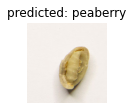

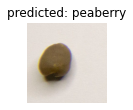

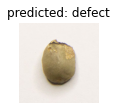

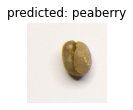

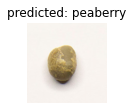

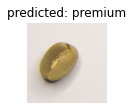

In [ ]:
visualize_model(model_ft)

## **memprediksi dari data uji**

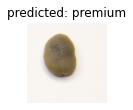

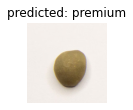

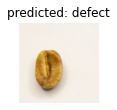

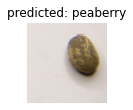

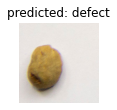

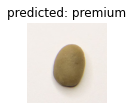

In [ ]:
# Visualizing the model predictions

def visualize_model(model, num_images=6):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['test']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title('predicted: {}'.format(class_names[preds[j]]))
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

visualize_model(model_ft)

## **memuat akurasi dari data uji**

In [ ]:
 def computeTestSetAccuracy(model, criterion):
    '''
    Function to compute the accuracy on the test set
    Parameters
        :param model: Model to test
        :param loss_criterion: Loss Criterion to minimize
    '''

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    test_acc = 0.0
    test_loss = 0.0

    # Validation - No gradient tracking needed
    with torch.no_grad():

        # Set to evaluation mode
        model.eval()

        # Validation loop
        for j, (inputs, labels) in enumerate((dataloaders['test'])):
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass - compute outputs on input data using the model
            outputs = model(inputs)

            # Compute loss
            loss = criterion(outputs, labels)

            # Compute the total loss for the batch and add it to valid_loss
            test_loss += loss.item() * inputs.size(0)

            # Calculate validation accuracy
            ret, predictions = torch.max(outputs.data, 1)
            correct_counts = predictions.eq(labels.data.view_as(predictions))

            # Convert correct_counts to float and then compute the mean
            acc = torch.mean(correct_counts.type(torch.FloatTensor))

            # Compute total accuracy in the whole batch and add to valid_acc
            test_acc += acc.item() * inputs.size(0)

            print("Test Batch number: {:03d}, Test: Loss: {:.4f}, Accuracy: {:.4f}".format(j, loss.item(), acc.item()))

    # Find average test loss and test accuracy
    avg_test_loss = test_loss/(dataset_sizes['test'])
    avg_test_acc = test_acc/(dataset_sizes['test'])

    print("\nTest accuracy : " + str(avg_test_acc))

In [ ]:
computeTestSetAccuracy(model_ft, criterion)

Test Batch number: 000, Test: Loss: 0.2848, Accuracy: 0.7500
Test Batch number: 001, Test: Loss: 0.2186, Accuracy: 1.0000
Test Batch number: 002, Test: Loss: 0.0684, Accuracy: 1.0000
Test Batch number: 003, Test: Loss: 0.1870, Accuracy: 1.0000
Test Batch number: 004, Test: Loss: 0.0705, Accuracy: 1.0000
Test Batch number: 005, Test: Loss: 0.3561, Accuracy: 0.7500
Test Batch number: 006, Test: Loss: 0.0728, Accuracy: 1.0000
Test Batch number: 007, Test: Loss: 0.2994, Accuracy: 0.7500
Test Batch number: 008, Test: Loss: 0.0138, Accuracy: 1.0000
Test Batch number: 009, Test: Loss: 0.0709, Accuracy: 1.0000
Test Batch number: 010, Test: Loss: 0.1560, Accuracy: 1.0000
Test Batch number: 011, Test: Loss: 0.1325, Accuracy: 1.0000
Test Batch number: 012, Test: Loss: 0.0657, Accuracy: 1.0000
Test Batch number: 013, Test: Loss: 0.0782, Accuracy: 1.0000
Test Batch number: 014, Test: Loss: 0.0559, Accuracy: 1.0000
Test Batch number: 015, Test: Loss: 0.0388, Accuracy: 1.0000
Test Batch number: 016, 

## **melakukan uji deteksi pada data uji**

In [ ]:
# Get a mapping of the indices to the class names, in order to see the output classes of the test images.
idx_to_class = {v: k for k, v in dataset['train'].class_to_idx.items()}
print(idx_to_class)

{0: 'defect', 1: 'longberry', 2: 'peaberry', 3: 'premium'}


In [ ]:
def predict(model, test_image_name):
    '''
    Function to predict the class of a single test image
    Parameters
        :param model: Model to test
        :param test_image_name: Test image
    '''

    transform = image_transforms['test']


    test_image = Image.open(test_image_name)
    plt.imshow(test_image)

    test_image_tensor = transform(test_image)

    if torch.cuda.is_available():
        test_image_tensor = test_image_tensor.view(1, 3, 256, 256).cuda()
    else:
        test_image_tensor = test_image_tensor.view(1, 3, 256, 256)

#    idx_to_class = {
#      "1":"defect",
#      "2":"longberry",
#      "3":"peaberry",
#      "4":"premium",
#    }

    with torch.no_grad():
        model.eval()
        # Model outputs log probabilities
        out = model(test_image_tensor)
        ps = torch.exp(out)

        topk, topclass = ps.topk(3, dim=1)
        cls = idx_to_class[topclass.cpu().numpy()[0][0]]
        score = topk.cpu().numpy()[0][0]

        for i in range(3):
            print("Prediction", i+1, ":", idx_to_class[topclass.cpu().numpy()[0][i]], ", Score: ", topk.cpu().numpy()[0][i])

In [ ]:
import torch.nn.functional as F

def predict(model, test_image_name):
    '''
    Function to predict the class of a single test image
    Parameters
        :param model: Model to test
        :param test_image_name: Test image
    '''

    transform = image_transforms['test']


    test_image = Image.open(test_image_name)
    plt.imshow(test_image)

    test_image_tensor = transform(test_image)

    if torch.cuda.is_available():
        test_image_tensor = test_image_tensor.view(1, 3, 256, 256).cuda()
    else:
        test_image_tensor = test_image_tensor.view(1, 3, 256, 256)

#    idx_to_class = {
#      "1":"defect",
#      "2":"longberry",
#      "3":"peaberry",
#      "4":"premium",
#    }

    with torch.no_grad():
        model.eval()
        # Model outputs log probabilities
        out = model(test_image_tensor)
        ps = F.softmax(out.data,dim=1)

        topk, topclass = ps.topk(4, dim=1)
        cls = idx_to_class[topclass.cpu().numpy()[0][0]]
        score = topk.cpu().numpy()[0][0]

        for i in range(4):
            print("Prediction", i+1, ":", idx_to_class[topclass.cpu().numpy()[0][i]], ",", end=" ")
            print("Score: {:.4f}%".format(topk.cpu().numpy()[0][i] * 100))

### Longberry

Actual       : Longberry
Prediction 1 : longberry , Score: 85.8315%
Prediction 2 : premium , Score: 13.9484%
Prediction 3 : defect , Score: 0.1838%
Prediction 4 : peaberry , Score: 0.0363%


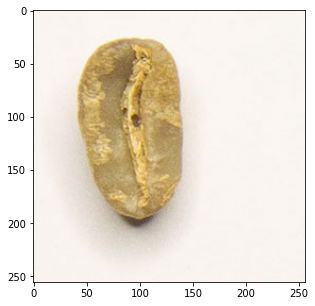

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1600.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.9760%
Prediction 2 : premium , Score: 0.0118%
Prediction 3 : defect , Score: 0.0106%
Prediction 4 : peaberry , Score: 0.0016%


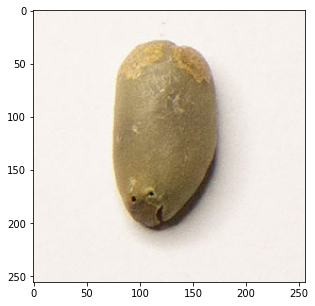

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1601.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 60.8494%
Prediction 2 : premium , Score: 37.9454%
Prediction 3 : defect , Score: 1.1691%
Prediction 4 : peaberry , Score: 0.0361%


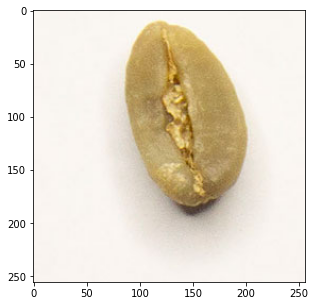

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1602.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 92.8758%
Prediction 2 : premium , Score: 3.0375%
Prediction 3 : peaberry , Score: 2.9976%
Prediction 4 : defect , Score: 1.0891%


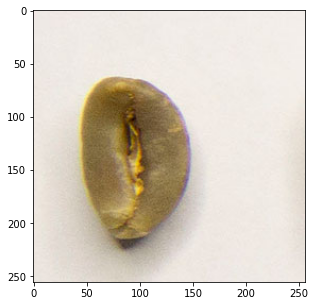

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1603.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 86.3637%
Prediction 2 : premium , Score: 10.4418%
Prediction 3 : defect , Score: 3.1619%
Prediction 4 : peaberry , Score: 0.0327%


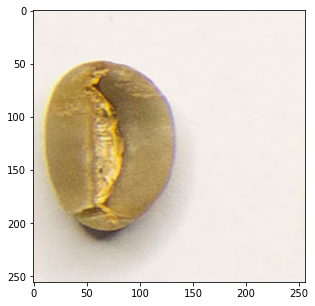

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1604.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.3954%
Prediction 2 : premium , Score: 0.2884%
Prediction 3 : peaberry , Score: 0.2550%
Prediction 4 : defect , Score: 0.0612%


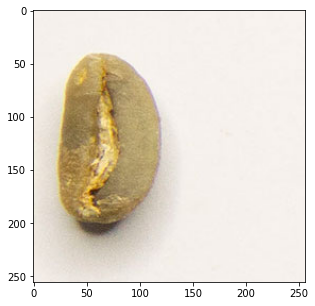

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1605.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.6236%
Prediction 2 : premium , Score: 0.3682%
Prediction 3 : peaberry , Score: 0.0041%
Prediction 4 : defect , Score: 0.0041%


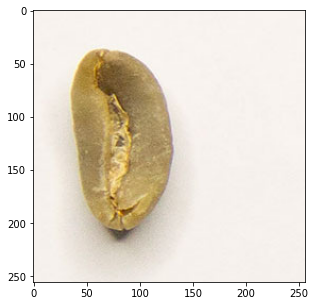

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1606.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 96.4157%
Prediction 2 : premium , Score: 3.1894%
Prediction 3 : defect , Score: 0.3856%
Prediction 4 : peaberry , Score: 0.0094%


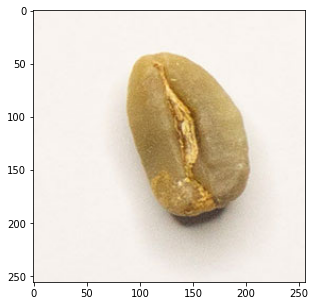

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1607.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 67.8010%
Prediction 2 : defect , Score: 18.8204%
Prediction 3 : peaberry , Score: 9.0960%
Prediction 4 : premium , Score: 4.2826%


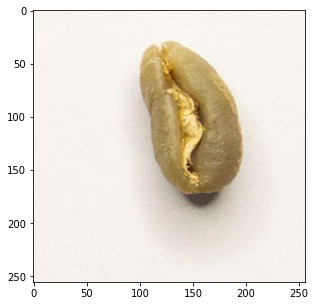

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1608.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 51.6362%
Prediction 2 : defect , Score: 26.8908%
Prediction 3 : peaberry , Score: 16.0766%
Prediction 4 : premium , Score: 5.3964%


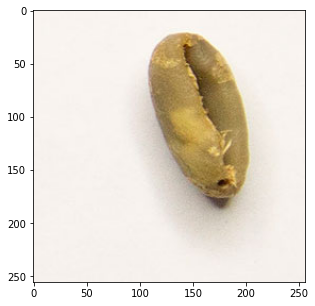

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1609.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.1970%
Prediction 2 : premium , Score: 0.7408%
Prediction 3 : peaberry , Score: 0.0458%
Prediction 4 : defect , Score: 0.0164%


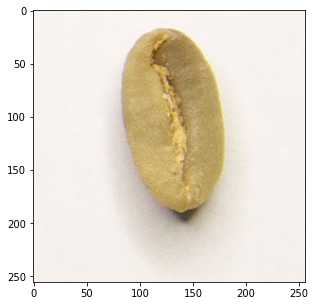

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1610.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.6329%
Prediction 2 : premium , Score: 0.3207%
Prediction 3 : defect , Score: 0.0345%
Prediction 4 : peaberry , Score: 0.0119%


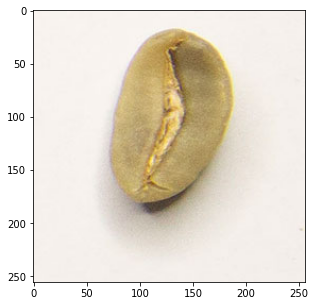

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1611.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.9930%
Prediction 2 : premium , Score: 0.0069%
Prediction 3 : peaberry , Score: 0.0000%
Prediction 4 : defect , Score: 0.0000%


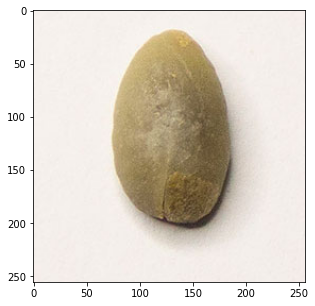

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1612.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.9843%
Prediction 2 : defect , Score: 0.0060%
Prediction 3 : peaberry , Score: 0.0051%
Prediction 4 : premium , Score: 0.0047%


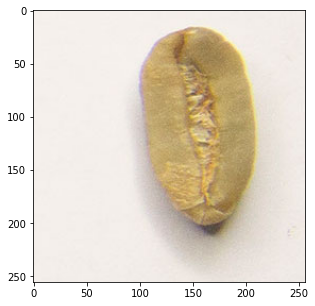

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1613.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 97.3093%
Prediction 2 : premium , Score: 2.6276%
Prediction 3 : peaberry , Score: 0.0321%
Prediction 4 : defect , Score: 0.0310%


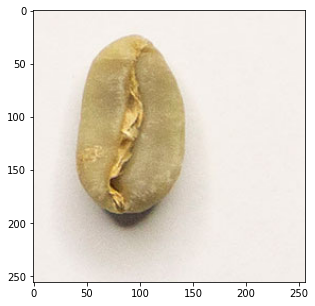

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1614.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.1566%
Prediction 2 : premium , Score: 0.5916%
Prediction 3 : peaberry , Score: 0.1754%
Prediction 4 : defect , Score: 0.0764%


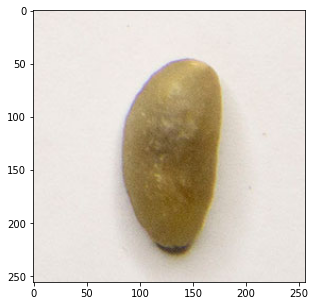

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1994.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 49.3399%
Prediction 2 : premium , Score: 46.4583%
Prediction 3 : defect , Score: 2.1985%
Prediction 4 : peaberry , Score: 2.0034%


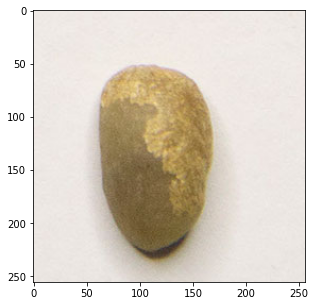

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1993.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.9433%
Prediction 2 : peaberry , Score: 0.0493%
Prediction 3 : defect , Score: 0.0045%
Prediction 4 : premium , Score: 0.0029%


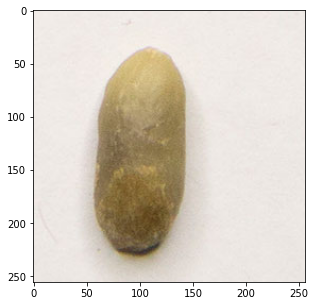

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1992.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 98.3876%
Prediction 2 : premium , Score: 1.5153%
Prediction 3 : defect , Score: 0.0560%
Prediction 4 : peaberry , Score: 0.0411%


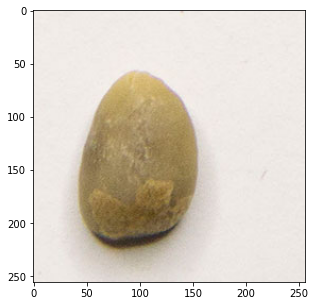

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1991.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 96.9956%
Prediction 2 : defect , Score: 2.5436%
Prediction 3 : premium , Score: 0.4380%
Prediction 4 : peaberry , Score: 0.0229%


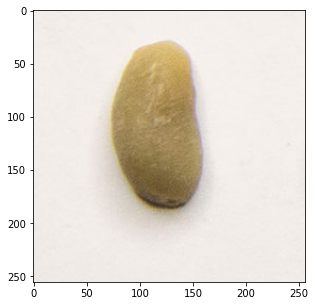

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1990.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.9785%
Prediction 2 : premium , Score: 0.0140%
Prediction 3 : defect , Score: 0.0044%
Prediction 4 : peaberry , Score: 0.0031%


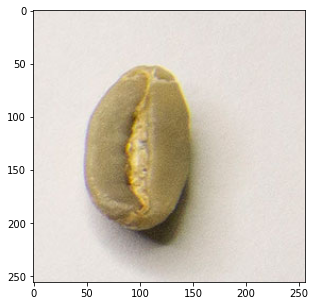

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1989.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 84.2911%
Prediction 2 : premium , Score: 15.3325%
Prediction 3 : defect , Score: 0.3524%
Prediction 4 : peaberry , Score: 0.0241%


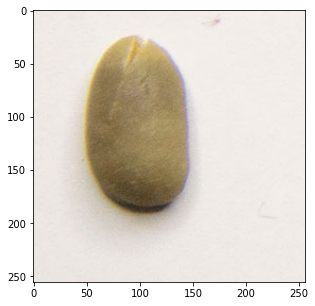

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1988.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.1543%
Prediction 2 : premium , Score: 0.6794%
Prediction 3 : defect , Score: 0.1065%
Prediction 4 : peaberry , Score: 0.0598%


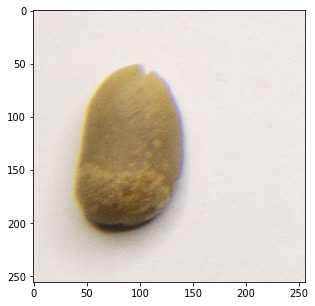

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1987.jpg'
print("Actual       : Longberry")
predict(model_ft, test)

### Defect

Actual       : Defect
Prediction 1 : defect , Score: 94.0804%
Prediction 2 : premium , Score: 5.8901%
Prediction 3 : longberry , Score: 0.0292%
Prediction 4 : peaberry , Score: 0.0002%


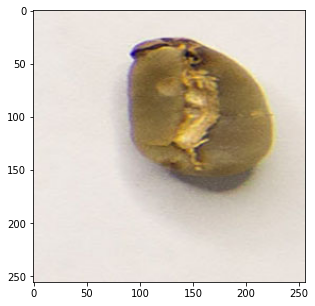

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1600.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 99.8190%
Prediction 2 : longberry , Score: 0.1278%
Prediction 3 : premium , Score: 0.0428%
Prediction 4 : peaberry , Score: 0.0104%


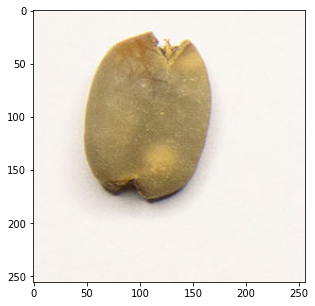

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1601.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : premium , Score: 69.6244%
Prediction 2 : peaberry , Score: 27.7348%
Prediction 3 : defect , Score: 2.0039%
Prediction 4 : longberry , Score: 0.6369%


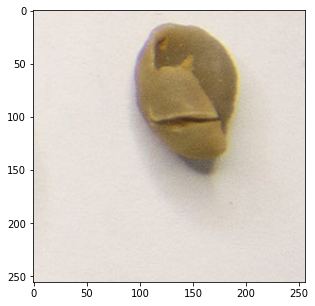

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1602.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 98.6911%
Prediction 2 : longberry , Score: 0.9605%
Prediction 3 : peaberry , Score: 0.3326%
Prediction 4 : premium , Score: 0.0158%


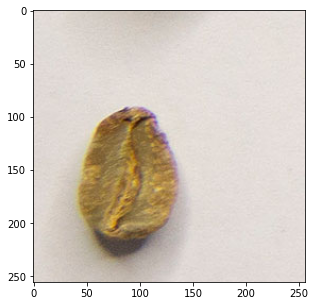

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1603.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 99.2469%
Prediction 2 : longberry , Score: 0.5526%
Prediction 3 : premium , Score: 0.1479%
Prediction 4 : peaberry , Score: 0.0526%


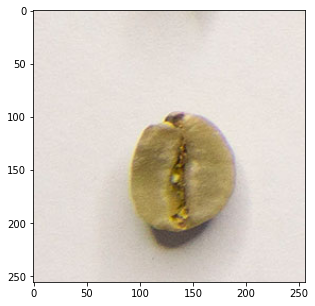

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1604.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 99.3172%
Prediction 2 : longberry , Score: 0.5872%
Prediction 3 : premium , Score: 0.0872%
Prediction 4 : peaberry , Score: 0.0084%


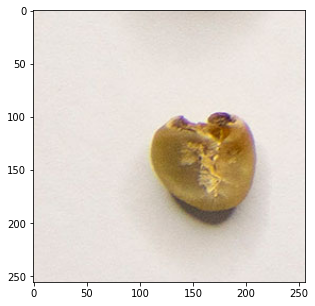

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1605.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 92.0266%
Prediction 2 : longberry , Score: 5.8180%
Prediction 3 : peaberry , Score: 1.2892%
Prediction 4 : premium , Score: 0.8663%


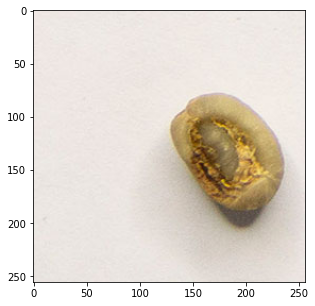

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1606.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 98.8819%
Prediction 2 : premium , Score: 0.6084%
Prediction 3 : longberry , Score: 0.4276%
Prediction 4 : peaberry , Score: 0.0821%


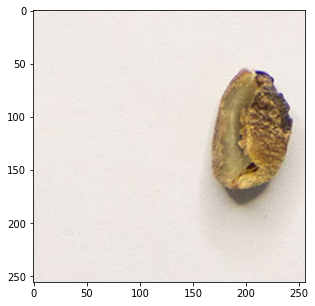

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1607.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 99.3188%
Prediction 2 : longberry , Score: 0.4847%
Prediction 3 : premium , Score: 0.1316%
Prediction 4 : peaberry , Score: 0.0649%


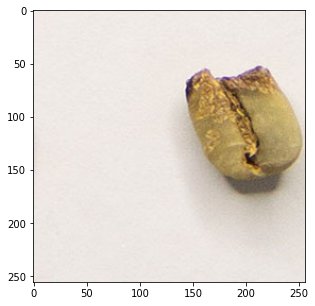

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1608.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 96.3630%
Prediction 2 : premium , Score: 2.0017%
Prediction 3 : longberry , Score: 1.6105%
Prediction 4 : peaberry , Score: 0.0248%


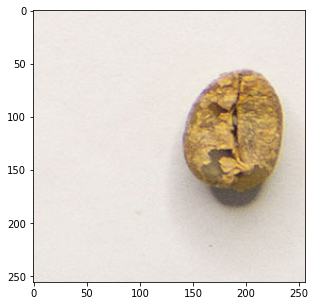

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1609.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 99.2904%
Prediction 2 : premium , Score: 0.5685%
Prediction 3 : longberry , Score: 0.1388%
Prediction 4 : peaberry , Score: 0.0023%


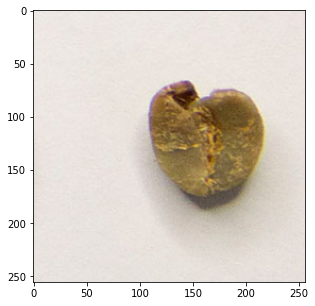

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1610.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 99.1455%
Prediction 2 : premium , Score: 0.5717%
Prediction 3 : longberry , Score: 0.2632%
Prediction 4 : peaberry , Score: 0.0195%


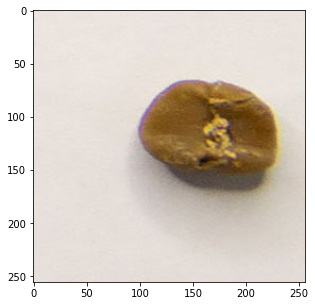

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1611.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 99.9342%
Prediction 2 : premium , Score: 0.0405%
Prediction 3 : peaberry , Score: 0.0159%
Prediction 4 : longberry , Score: 0.0094%


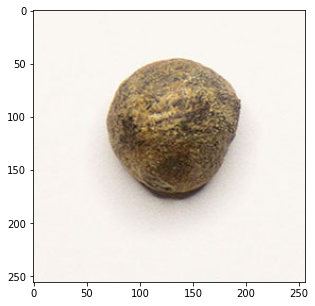

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1612.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 99.8770%
Prediction 2 : premium , Score: 0.1171%
Prediction 3 : peaberry , Score: 0.0048%
Prediction 4 : longberry , Score: 0.0012%


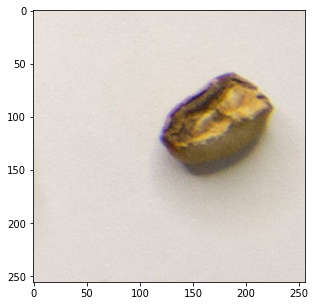

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1613.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 97.6296%
Prediction 2 : premium , Score: 2.0892%
Prediction 3 : longberry , Score: 0.2709%
Prediction 4 : peaberry , Score: 0.0103%


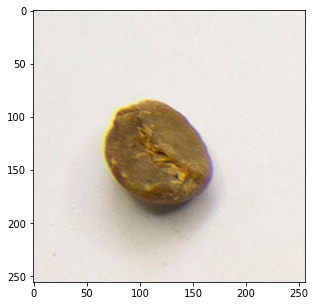

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1614.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : peaberry , Score: 61.6418%
Prediction 2 : premium , Score: 32.1942%
Prediction 3 : longberry , Score: 4.0064%
Prediction 4 : defect , Score: 2.1576%


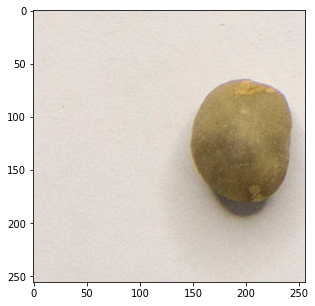

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1994.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 92.1344%
Prediction 2 : premium , Score: 4.9595%
Prediction 3 : longberry , Score: 2.8671%
Prediction 4 : peaberry , Score: 0.0391%


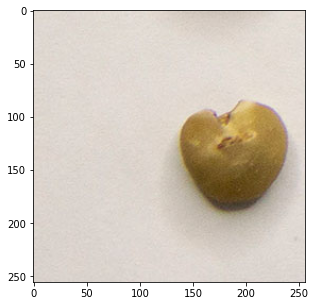

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1993.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 88.5056%
Prediction 2 : premium , Score: 10.7550%
Prediction 3 : longberry , Score: 0.6933%
Prediction 4 : peaberry , Score: 0.0461%


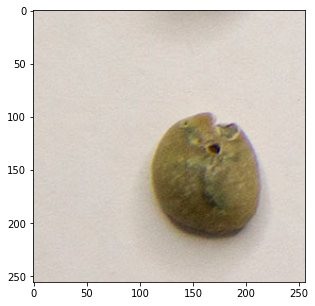

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1992.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 98.3705%
Prediction 2 : longberry , Score: 0.9425%
Prediction 3 : peaberry , Score: 0.3917%
Prediction 4 : premium , Score: 0.2953%


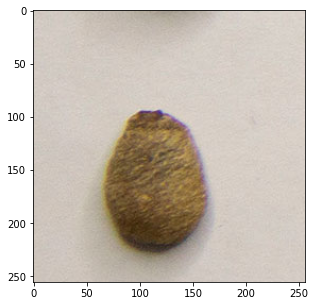

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1991.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : peaberry , Score: 92.0042%
Prediction 2 : premium , Score: 7.5221%
Prediction 3 : longberry , Score: 0.3883%
Prediction 4 : defect , Score: 0.0855%


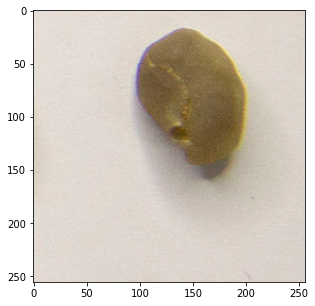

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1990.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 99.0716%
Prediction 2 : premium , Score: 0.7639%
Prediction 3 : peaberry , Score: 0.1460%
Prediction 4 : longberry , Score: 0.0185%


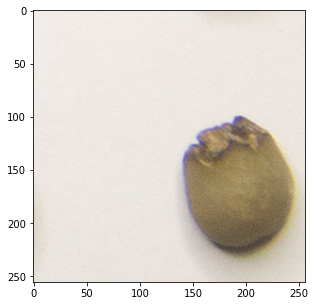

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1989.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 68.7711%
Prediction 2 : premium , Score: 31.1494%
Prediction 3 : longberry , Score: 0.0704%
Prediction 4 : peaberry , Score: 0.0092%


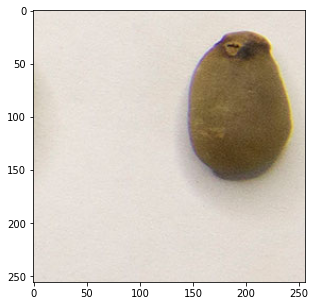

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1988.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 45.8566%
Prediction 2 : longberry , Score: 32.8700%
Prediction 3 : premium , Score: 21.1315%
Prediction 4 : peaberry , Score: 0.1419%


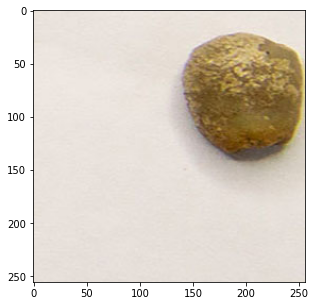

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1987.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 94.4039%
Prediction 2 : premium , Score: 3.0893%
Prediction 3 : longberry , Score: 1.6732%
Prediction 4 : peaberry , Score: 0.8335%


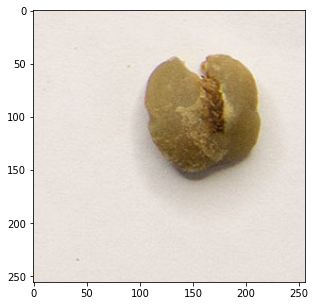

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1986.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : premium , Score: 54.0581%
Prediction 2 : defect , Score: 39.2864%
Prediction 3 : longberry , Score: 6.6449%
Prediction 4 : peaberry , Score: 0.0106%


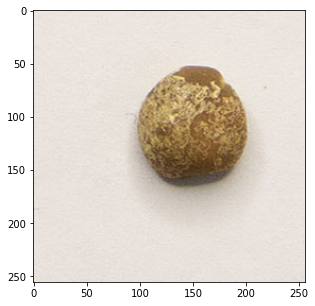

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1985.jpg'
print("Actual       : Defect")
predict(model_ft, test)

Actual       : Defect
Prediction 1 : defect , Score: 95.6061%
Prediction 2 : longberry , Score: 3.3273%
Prediction 3 : premium , Score: 1.0594%
Prediction 4 : peaberry , Score: 0.0071%


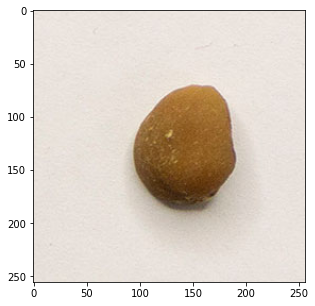

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1984.jpg'
print("Actual       : Defect")
predict(model_ft, test)

### Peaberry

Actual       : Peaberry
Prediction 1 : peaberry , Score: 59.6999%
Prediction 2 : premium , Score: 40.2815%
Prediction 3 : defect , Score: 0.0124%
Prediction 4 : longberry , Score: 0.0062%


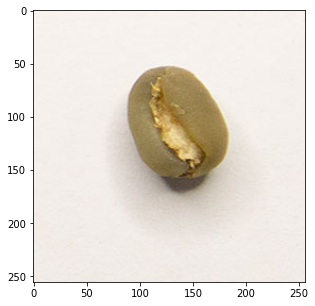

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1604.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 98.0320%
Prediction 2 : premium , Score: 1.7226%
Prediction 3 : longberry , Score: 0.1784%
Prediction 4 : defect , Score: 0.0669%


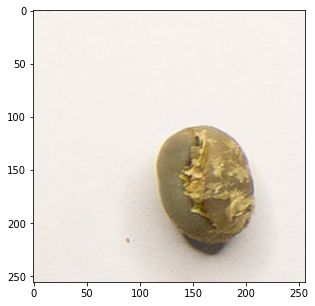

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1600.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 99.0214%
Prediction 2 : premium , Score: 0.7808%
Prediction 3 : defect , Score: 0.1885%
Prediction 4 : longberry , Score: 0.0093%


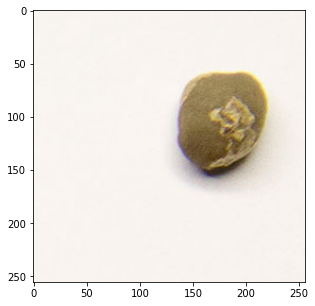

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1601.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 75.3360%
Prediction 2 : premium , Score: 11.4243%
Prediction 3 : defect , Score: 7.0221%
Prediction 4 : longberry , Score: 6.2176%


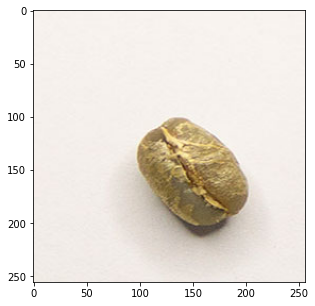

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1602.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 87.0267%
Prediction 2 : premium , Score: 12.9285%
Prediction 3 : longberry , Score: 0.0317%
Prediction 4 : defect , Score: 0.0132%


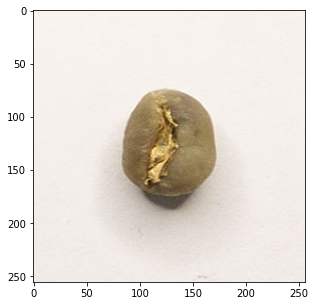

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1603.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 79.8839%
Prediction 2 : premium , Score: 19.8440%
Prediction 3 : defect , Score: 0.1610%
Prediction 4 : longberry , Score: 0.1111%


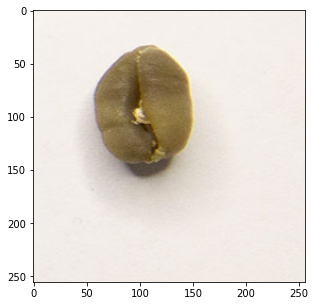

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1605.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 86.9093%
Prediction 2 : premium , Score: 12.9986%
Prediction 3 : longberry , Score: 0.0858%
Prediction 4 : defect , Score: 0.0064%


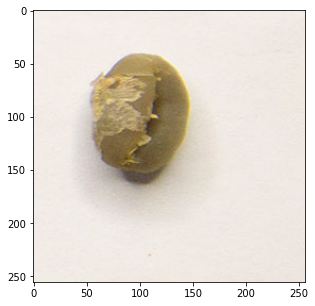

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1606.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : premium , Score: 49.5803%
Prediction 2 : peaberry , Score: 38.5383%
Prediction 3 : defect , Score: 11.3950%
Prediction 4 : longberry , Score: 0.4864%


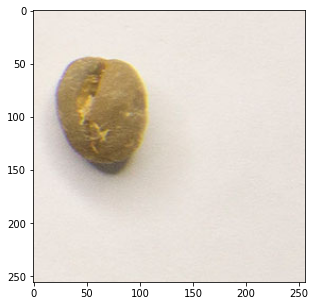

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1607.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : premium , Score: 53.3280%
Prediction 2 : peaberry , Score: 43.9062%
Prediction 3 : defect , Score: 1.8600%
Prediction 4 : longberry , Score: 0.9058%


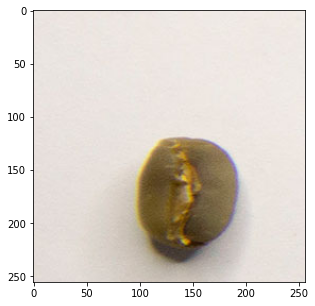

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1608.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 95.9661%
Prediction 2 : premium , Score: 2.0073%
Prediction 3 : longberry , Score: 1.3796%
Prediction 4 : defect , Score: 0.6469%


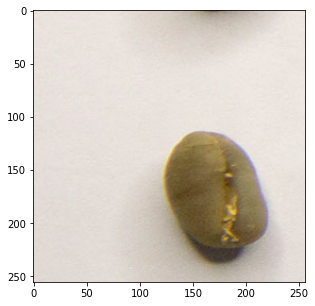

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1609.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 96.3016%
Prediction 2 : premium , Score: 1.8286%
Prediction 3 : longberry , Score: 1.2969%
Prediction 4 : defect , Score: 0.5729%


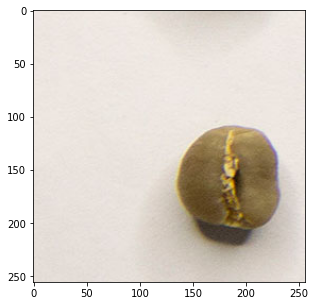

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1610.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 93.6600%
Prediction 2 : premium , Score: 5.0964%
Prediction 3 : defect , Score: 0.8208%
Prediction 4 : longberry , Score: 0.4228%


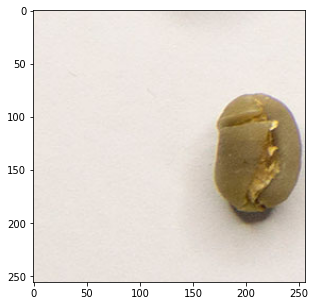

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1611.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 92.5342%
Prediction 2 : premium , Score: 7.3470%
Prediction 3 : defect , Score: 0.0824%
Prediction 4 : longberry , Score: 0.0364%


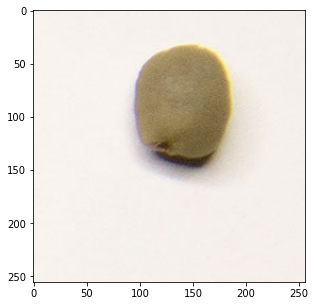

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1612.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 91.6413%
Prediction 2 : premium , Score: 7.1159%
Prediction 3 : defect , Score: 0.9035%
Prediction 4 : longberry , Score: 0.3393%


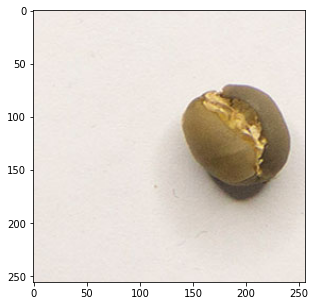

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1613.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 87.7916%
Prediction 2 : premium , Score: 12.1709%
Prediction 3 : longberry , Score: 0.0214%
Prediction 4 : defect , Score: 0.0161%


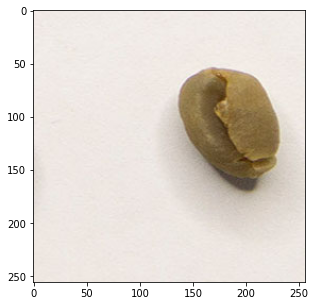

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1614.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 84.2136%
Prediction 2 : premium , Score: 15.7837%
Prediction 3 : defect , Score: 0.0026%
Prediction 4 : longberry , Score: 0.0000%


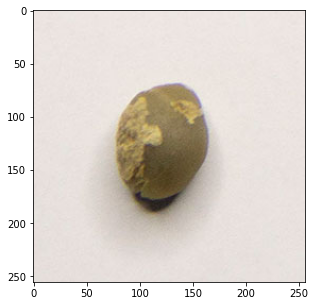

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1995.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 96.6604%
Prediction 2 : premium , Score: 3.2876%
Prediction 3 : defect , Score: 0.0517%
Prediction 4 : longberry , Score: 0.0003%


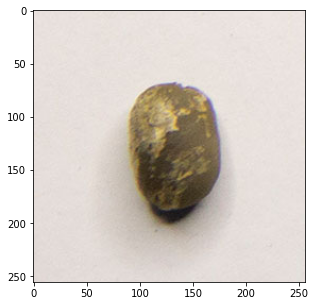

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1994.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 78.5496%
Prediction 2 : premium , Score: 19.8375%
Prediction 3 : defect , Score: 1.5312%
Prediction 4 : longberry , Score: 0.0817%


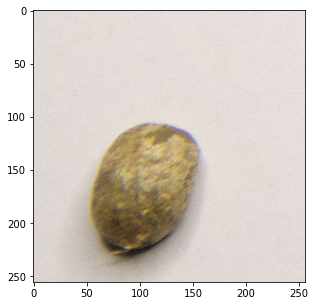

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1993.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 95.9390%
Prediction 2 : premium , Score: 4.0312%
Prediction 3 : longberry , Score: 0.0212%
Prediction 4 : defect , Score: 0.0086%


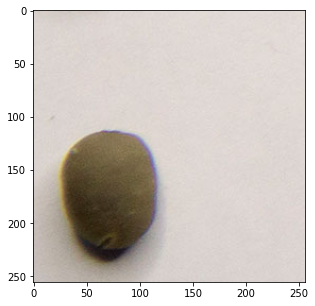

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1992.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 97.3737%
Prediction 2 : premium , Score: 2.6075%
Prediction 3 : defect , Score: 0.0187%
Prediction 4 : longberry , Score: 0.0001%


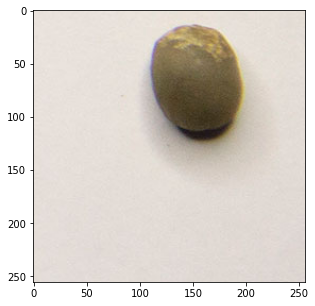

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1991.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 89.7161%
Prediction 2 : premium , Score: 10.2787%
Prediction 3 : defect , Score: 0.0051%
Prediction 4 : longberry , Score: 0.0000%


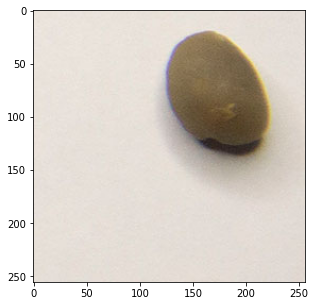

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1990.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 99.8747%
Prediction 2 : longberry , Score: 0.1179%
Prediction 3 : premium , Score: 0.0071%
Prediction 4 : defect , Score: 0.0003%


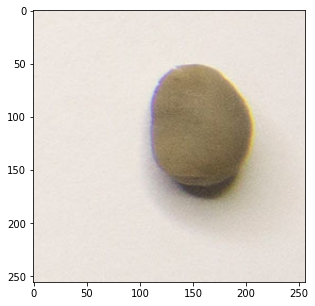

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1989.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 76.4534%
Prediction 2 : premium , Score: 23.5252%
Prediction 3 : defect , Score: 0.0214%
Prediction 4 : longberry , Score: 0.0000%


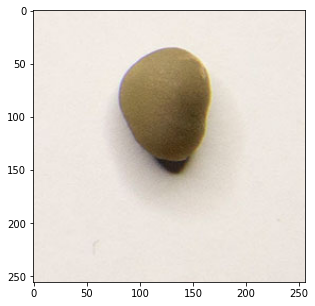

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1988.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 64.3210%
Prediction 2 : premium , Score: 35.6781%
Prediction 3 : defect , Score: 0.0009%
Prediction 4 : longberry , Score: 0.0000%


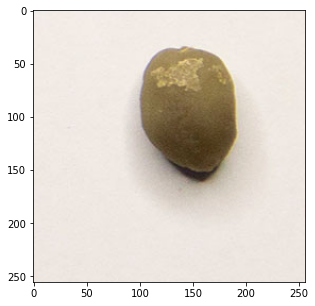

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1987.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 78.9212%
Prediction 2 : premium , Score: 21.0238%
Prediction 3 : defect , Score: 0.0546%
Prediction 4 : longberry , Score: 0.0004%


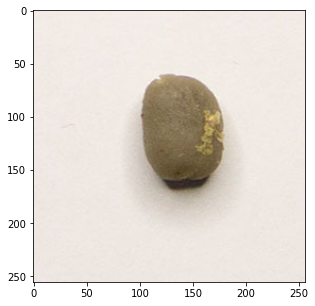

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1986.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 80.3240%
Prediction 2 : defect , Score: 17.9723%
Prediction 3 : premium , Score: 1.6920%
Prediction 4 : longberry , Score: 0.0117%


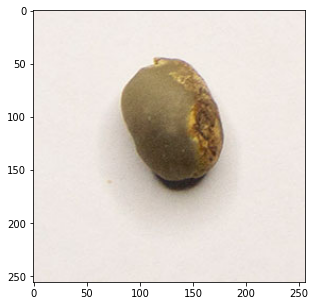

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1985.jpg'
print("Actual       : Peaberry")
predict(model_ft, test)

### Premium

Actual       : Premium
Prediction 1 : premium , Score: 97.2332%
Prediction 2 : defect , Score: 1.5373%
Prediction 3 : longberry , Score: 1.1922%
Prediction 4 : peaberry , Score: 0.0372%


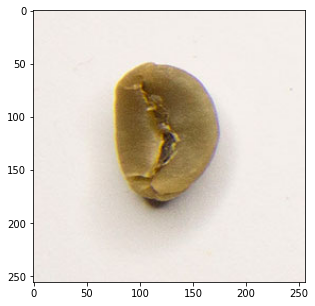

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1637.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 99.9830%
Prediction 2 : defect , Score: 0.0119%
Prediction 3 : peaberry , Score: 0.0050%
Prediction 4 : longberry , Score: 0.0001%


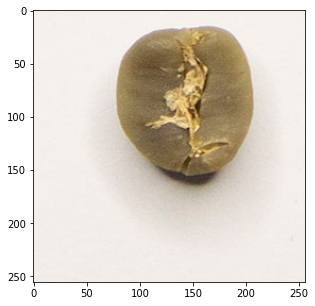

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1600.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 97.4603%
Prediction 2 : longberry , Score: 1.5684%
Prediction 3 : defect , Score: 0.7168%
Prediction 4 : peaberry , Score: 0.2545%


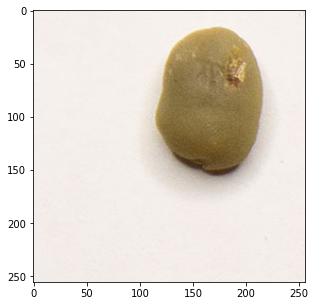

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1601.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 98.2752%
Prediction 2 : defect , Score: 1.6969%
Prediction 3 : longberry , Score: 0.0221%
Prediction 4 : peaberry , Score: 0.0059%


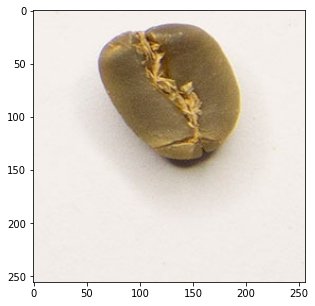

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1602.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 83.8393%
Prediction 2 : defect , Score: 15.0220%
Prediction 3 : longberry , Score: 1.0752%
Prediction 4 : peaberry , Score: 0.0635%


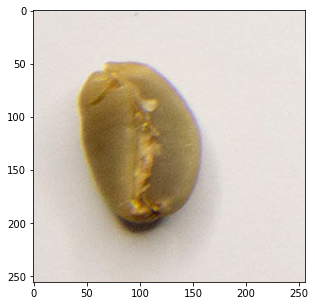

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1603.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 98.7829%
Prediction 2 : defect , Score: 0.6511%
Prediction 3 : longberry , Score: 0.5589%
Prediction 4 : peaberry , Score: 0.0071%


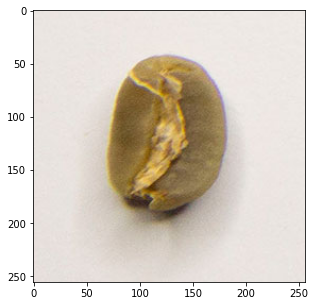

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1604.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 93.1344%
Prediction 2 : longberry , Score: 4.4243%
Prediction 3 : defect , Score: 2.4390%
Prediction 4 : peaberry , Score: 0.0022%


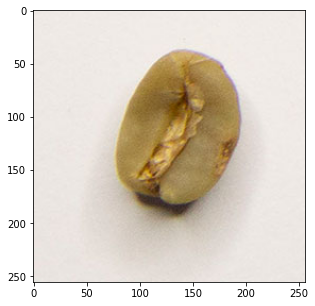

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1605.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 98.7884%
Prediction 2 : defect , Score: 0.6605%
Prediction 3 : longberry , Score: 0.3130%
Prediction 4 : peaberry , Score: 0.2381%


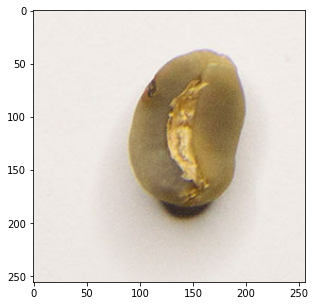

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1606.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 99.9559%
Prediction 2 : longberry , Score: 0.0294%
Prediction 3 : defect , Score: 0.0087%
Prediction 4 : peaberry , Score: 0.0060%


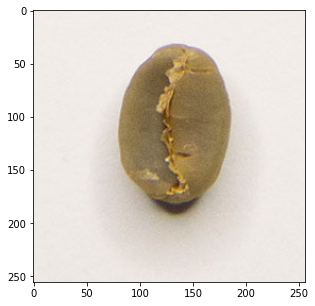

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1607.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 99.6451%
Prediction 2 : defect , Score: 0.3352%
Prediction 3 : longberry , Score: 0.0169%
Prediction 4 : peaberry , Score: 0.0028%


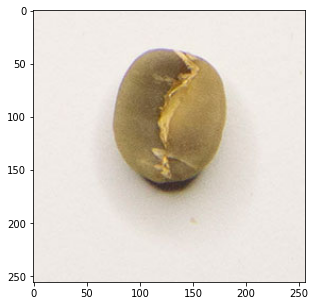

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1608.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 76.1927%
Prediction 2 : defect , Score: 22.5362%
Prediction 3 : longberry , Score: 1.2658%
Prediction 4 : peaberry , Score: 0.0053%


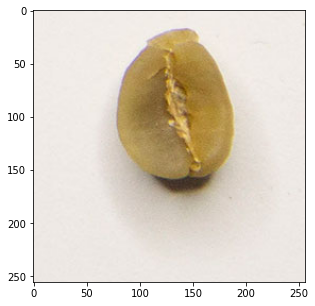

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1609.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 99.1448%
Prediction 2 : defect , Score: 0.6028%
Prediction 3 : longberry , Score: 0.2259%
Prediction 4 : peaberry , Score: 0.0264%


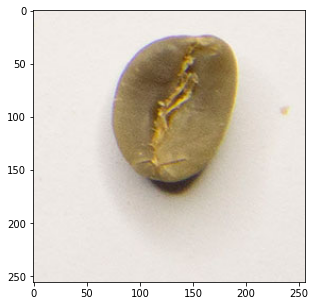

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1610.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 90.9446%
Prediction 2 : defect , Score: 8.3543%
Prediction 3 : longberry , Score: 0.5842%
Prediction 4 : peaberry , Score: 0.1169%


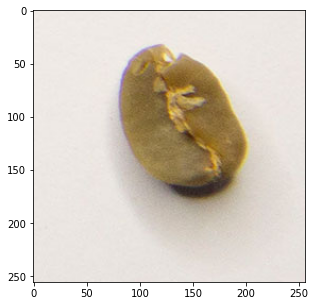

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1611.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 98.7854%
Prediction 2 : peaberry , Score: 1.2113%
Prediction 3 : defect , Score: 0.0020%
Prediction 4 : longberry , Score: 0.0013%


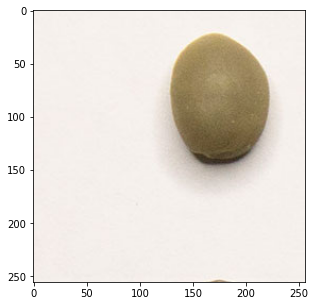

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1612.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 99.1567%
Prediction 2 : defect , Score: 0.4312%
Prediction 3 : peaberry , Score: 0.4098%
Prediction 4 : longberry , Score: 0.0023%


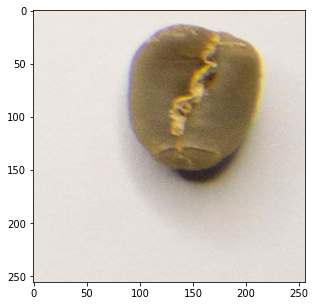

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1613.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : defect , Score: 51.0450%
Prediction 2 : premium , Score: 44.9946%
Prediction 3 : longberry , Score: 3.6203%
Prediction 4 : peaberry , Score: 0.3401%


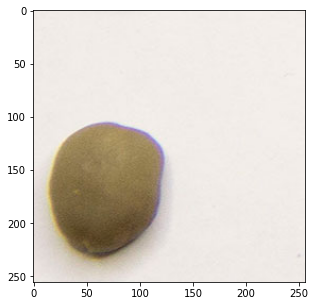

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1992.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : longberry , Score: 49.5053%
Prediction 2 : premium , Score: 37.2021%
Prediction 3 : defect , Score: 13.1971%
Prediction 4 : peaberry , Score: 0.0955%


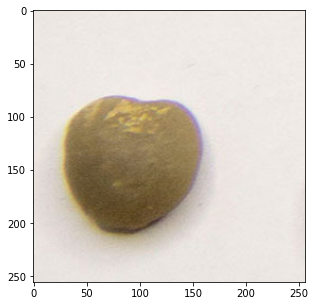

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1991.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 99.6257%
Prediction 2 : defect , Score: 0.3308%
Prediction 3 : longberry , Score: 0.0421%
Prediction 4 : peaberry , Score: 0.0014%


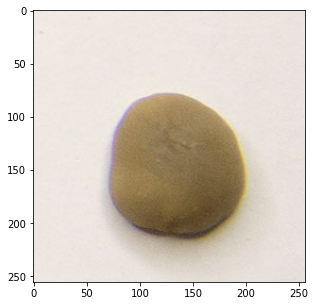

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1990.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 99.9525%
Prediction 2 : peaberry , Score: 0.0402%
Prediction 3 : defect , Score: 0.0070%
Prediction 4 : longberry , Score: 0.0003%


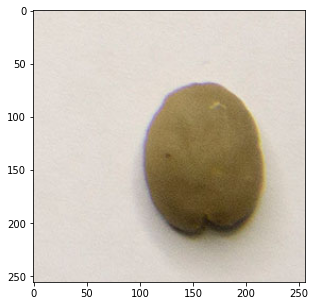

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1989.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 99.5049%
Prediction 2 : defect , Score: 0.3949%
Prediction 3 : longberry , Score: 0.0836%
Prediction 4 : peaberry , Score: 0.0166%


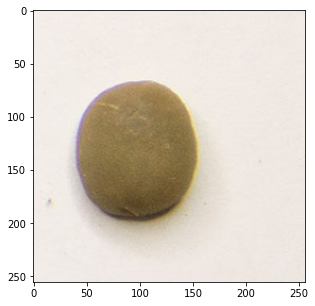

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1988.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 89.1319%
Prediction 2 : defect , Score: 7.0807%
Prediction 3 : longberry , Score: 3.2394%
Prediction 4 : peaberry , Score: 0.5480%


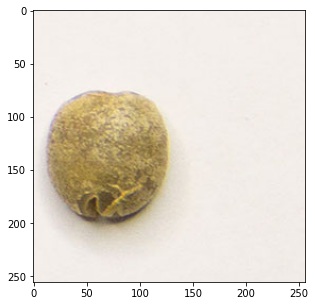

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1987.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 93.8718%
Prediction 2 : defect , Score: 3.4854%
Prediction 3 : longberry , Score: 2.4846%
Prediction 4 : peaberry , Score: 0.1581%


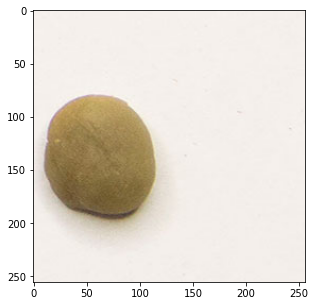

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1986.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 97.6519%
Prediction 2 : defect , Score: 1.6603%
Prediction 3 : longberry , Score: 0.5750%
Prediction 4 : peaberry , Score: 0.1127%


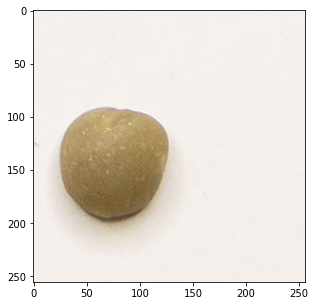

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1985.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 94.6077%
Prediction 2 : defect , Score: 4.6178%
Prediction 3 : longberry , Score: 0.7036%
Prediction 4 : peaberry , Score: 0.0709%


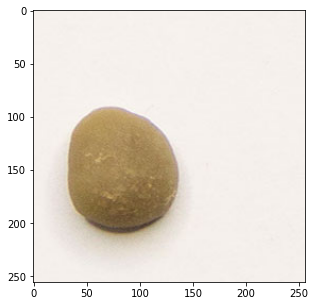

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1984.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 61.8454%
Prediction 2 : defect , Score: 35.9965%
Prediction 3 : longberry , Score: 2.0797%
Prediction 4 : peaberry , Score: 0.0785%


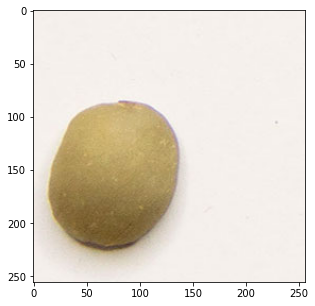

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1983.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : defect , Score: 37.0059%
Prediction 2 : premium , Score: 33.5407%
Prediction 3 : longberry , Score: 28.3148%
Prediction 4 : peaberry , Score: 1.1386%


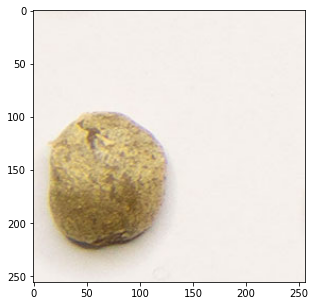

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1982.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 69.9055%
Prediction 2 : defect , Score: 29.5451%
Prediction 3 : longberry , Score: 0.5124%
Prediction 4 : peaberry , Score: 0.0370%


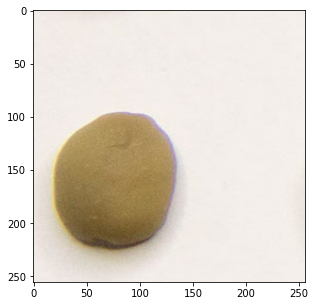

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1981.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 55.5091%
Prediction 2 : longberry , Score: 27.0196%
Prediction 3 : defect , Score: 17.4429%
Prediction 4 : peaberry , Score: 0.0284%


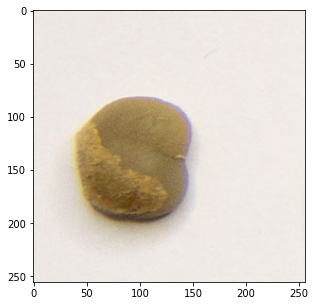

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1980.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 99.7800%
Prediction 2 : defect , Score: 0.1746%
Prediction 3 : longberry , Score: 0.0274%
Prediction 4 : peaberry , Score: 0.0179%


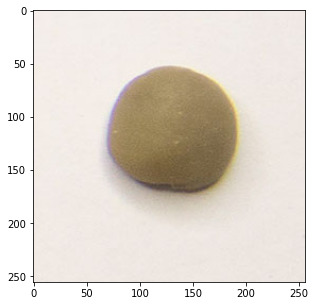

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1979.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 99.9763%
Prediction 2 : peaberry , Score: 0.0124%
Prediction 3 : defect , Score: 0.0074%
Prediction 4 : longberry , Score: 0.0039%


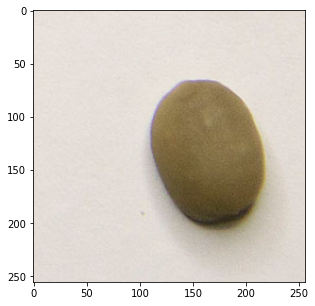

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1978.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 95.7309%
Prediction 2 : defect , Score: 3.3402%
Prediction 3 : longberry , Score: 0.9237%
Prediction 4 : peaberry , Score: 0.0052%


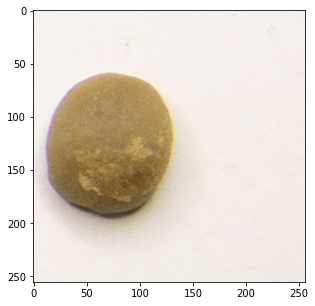

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1977.jpg'
print("Actual       : Premium")
predict(model_ft, test)

Actual       : Premium
Prediction 1 : premium , Score: 95.3842%
Prediction 2 : longberry , Score: 4.2663%
Prediction 3 : defect , Score: 0.3294%
Prediction 4 : peaberry , Score: 0.0201%


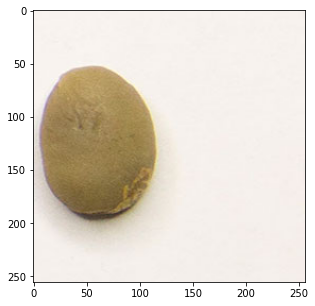

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1976.jpg'
print("Actual       : Premium")
predict(model_ft, test)

## **Mengevaluasi model**

In [ ]:
nb_classes = 4

confusion_matrix = torch.zeros(nb_classes, nb_classes)
with torch.no_grad():
    for i, (inputs, classes) in enumerate(dataloaders['test']):
        inputs = inputs.to(device)
        classes = classes.to(device)
        outputs = model_ft(inputs)
        _, preds = torch.max(outputs, 1)
        for t, p in zip(classes.view(-1), preds.view(-1)):
                confusion_matrix[t.long(), p.long()] += 1

print(confusion_matrix)

tensor([[349.,  15.,  11.,  25.],
        [  3., 364.,   4.,  29.],
        [  6.,   0., 285., 109.],
        [ 20.,   5.,   4., 371.]])


In [ ]:
def plot_confusion_matrix(cm,
                          target_names,
                          title='Confusion matrix',
                          cmap=None,
                          normalize=True):

    import matplotlib.pyplot as plt
    import numpy as np
    import itertools

    accuracy = np.trace(cm) / float(np.sum(cm))
    misclass = 1 - accuracy

    if cmap is None:
        cmap = plt.get_cmap('Blues')

    plt.figure(figsize=(8, 6))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()

    if target_names is not None:
        tick_marks = np.arange(len(target_names))
        plt.xticks(tick_marks, target_names, rotation=45)
        plt.yticks(tick_marks, target_names)

    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    thresh = cm.max() / 1.5 if normalize else cm.max() / 2
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        if normalize:
            plt.text(j, i, "{:0.4f}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")
        else:
            plt.text(j, i, "{:,}".format(cm[i, j]),
                     horizontalalignment="center",
                     color="white" if cm[i, j] > thresh else "black")


    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label\naccuracy={:0.4f}; misclass={:0.4f}'.format(accuracy, misclass))
    plt.show()

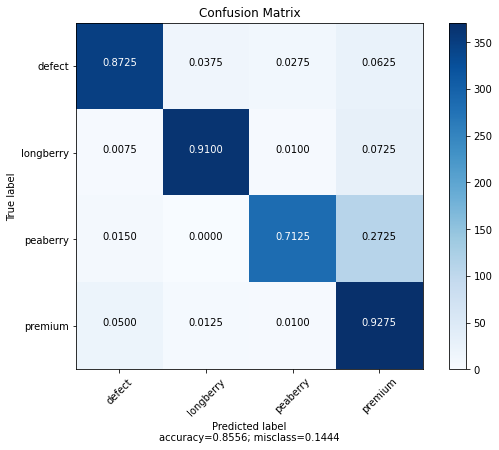

In [ ]:
plot_confusion_matrix(cm           = np.array([[349.,  15.,  11.,  25.],
        [  3., 364.,   4.,  29.],
        [  6.,   0., 285., 109.],
        [ 20.,   5.,   4., 371.]]),
                      normalize    = True,
                      target_names = ['defect', 'longberry', 'peaberry', 'premium'],
                      title        = "Confusion Matrix")

In [ ]:
#To get the per-class accuracy:

print(confusion_matrix.diag()/confusion_matrix.sum(1))

tensor([0.8725, 0.9100, 0.7125, 0.9275])


# **PERCOBAAN 2**

## **Device default**

In [ ]:
# membuat device default sebagai gpu, jika ada
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

In [ ]:
images, labels = images.to(device), labels.to(device)

## **Percobaan 2: MobileNetV2**

In [ ]:
# memuat pre-trained model yaitu MobileNetV2
print("\nLoading mobilenetv2 as feature extractor ...\n")
model_tl = models.mobilenet_v2(pretrained=True)

# Freeze all the required layers (i.e except last conv block and fc layers)
for params in list(model_tl.parameters())[0:-5]:
  params.requires_grad = False

# Modify fc layers to match num_classes
num_ftrs=model_tl.classifier[-1].in_features

model_tl.classifier=nn.Sequential(
    nn.Dropout(p=0.2, inplace=False),
    nn.Linear(in_features=num_ftrs, out_features=num_classes, bias=True)
    )

# Transfer the model to GPU
model_tl = model_tl.to(device)

# Print model summary
print('Model Summary:-\n')
for num, (name, param) in enumerate(model_tl.named_parameters()):
    print(num, name, param.requires_grad )

# Loss function
criterion = nn.CrossEntropyLoss()

# Optimizer
optimizer_tl = optim.Adam(model_tl.parameters(), lr=0.001)

# Learning rate decay
exp_lr_scheduler = lr_scheduler.StepLR(optimizer_tl, step_size=7, gamma=0.1)


Loading mobilenetv2 as feature extractor ...



Downloading: "https://download.pytorch.org/models/mobilenet_v2-b0353104.pth" to /root/.cache/torch/hub/checkpoints/mobilenet_v2-b0353104.pth


  0%|          | 0.00/13.6M [00:00<?, ?B/s]

Model Summary:-

0 features.0.0.weight False
1 features.0.1.weight False
2 features.0.1.bias False
3 features.1.conv.0.0.weight False
4 features.1.conv.0.1.weight False
5 features.1.conv.0.1.bias False
6 features.1.conv.1.weight False
7 features.1.conv.2.weight False
8 features.1.conv.2.bias False
9 features.2.conv.0.0.weight False
10 features.2.conv.0.1.weight False
11 features.2.conv.0.1.bias False
12 features.2.conv.1.0.weight False
13 features.2.conv.1.1.weight False
14 features.2.conv.1.1.bias False
15 features.2.conv.2.weight False
16 features.2.conv.3.weight False
17 features.2.conv.3.bias False
18 features.3.conv.0.0.weight False
19 features.3.conv.0.1.weight False
20 features.3.conv.0.1.bias False
21 features.3.conv.1.0.weight False
22 features.3.conv.1.1.weight False
23 features.3.conv.1.1.bias False
24 features.3.conv.2.weight False
25 features.3.conv.3.weight False
26 features.3.conv.3.bias False
27 features.4.conv.0.0.weight False
28 features.4.conv.0.1.weight False
29 fea

In [ ]:
# mencetak ringkasan model
print('Model Summary:-\n')
summary(model_tl, input_size=(3, 256, 256))
print(model_tl)

Model Summary:-

----------------------------------------------------------------
        Layer (type)               Output Shape         Param #
            Conv2d-1         [-1, 32, 128, 128]             864
       BatchNorm2d-2         [-1, 32, 128, 128]              64
             ReLU6-3         [-1, 32, 128, 128]               0
            Conv2d-4         [-1, 32, 128, 128]             288
       BatchNorm2d-5         [-1, 32, 128, 128]              64
             ReLU6-6         [-1, 32, 128, 128]               0
            Conv2d-7         [-1, 16, 128, 128]             512
       BatchNorm2d-8         [-1, 16, 128, 128]              32
  InvertedResidual-9         [-1, 16, 128, 128]               0
           Conv2d-10         [-1, 96, 128, 128]           1,536
      BatchNorm2d-11         [-1, 96, 128, 128]             192
            ReLU6-12         [-1, 96, 128, 128]               0
           Conv2d-13           [-1, 96, 64, 64]             864
      BatchNorm2d-14  

In [ ]:
writer=SummaryWriter('/content/content/runs/summary_model_2')
writer.add_graph(model_tl, images)

## **melatih model pada percobaan 2**

In [ ]:
# Melatih model
print("\nTraining:-\n")

def train_model(model, criterion, optimizer, scheduler, num_epochs=30):
    since = time.time()

    best_model_wts = copy.deepcopy(model.state_dict())
    best_acc = 0.0

    # Tensorboard summary
    writer = SummaryWriter("content/runs/model_percobaan_2")

    for epoch in range(num_epochs):
        print('Epoch {}/{}'.format(epoch, num_epochs - 1))
        print('-' * 10)

        # Each epoch has a training and validation phase
        for phase in ['train', 'val']:
            if phase == 'train':
                model.train()  # Set model to training mode
            else:
                model.eval()   # Set model to evaluate mode

            running_loss = 0.0
            running_corrects = 0

            # Iterate over data.
            for inputs, labels in dataloaders[phase]:
                inputs = inputs.to(device, non_blocking=True)
                labels = labels.to(device, non_blocking=True)

                # zero the parameter gradients
                optimizer.zero_grad()

                # forward
                # track history if only in train
                with torch.set_grad_enabled(phase == 'train'):
                    outputs = model(inputs)
                    _, preds = torch.max(outputs, 1)
                    loss = criterion(outputs, labels)

                    # backward + optimize only if in training phase
                    if phase == 'train':
                        loss.backward()
                        optimizer.step()

                # statistics
                running_loss += loss.item() * inputs.size(0)
                running_corrects += torch.sum(preds == labels.data)
            if phase == 'train':
                scheduler.step()

            epoch_loss = running_loss / dataset_sizes[phase]
            epoch_acc = running_corrects.double() / dataset_sizes[phase]

            print('{} Loss: {:.4f} Acc: {:.4f}'.format(
                phase, epoch_loss, epoch_acc))

            # Record training loss and accuracy for each phase
            if phase == 'train':
                writer.add_scalar('Train/Loss', epoch_loss, epoch)
                writer.add_scalar('Train/Accuracy', epoch_acc, epoch)
                writer.flush()
            else:
                writer.add_scalar('Valid/Loss', epoch_loss, epoch)
                writer.add_scalar('Valid/Accuracy', epoch_acc, epoch)
                writer.flush()

            # deep copy the model
            if phase == 'val' and epoch_acc > best_acc:
                best_acc = epoch_acc
                best_model_wts = copy.deepcopy(model.state_dict())

        print()

    time_elapsed = time.time() - since
    print('Training complete in {:.0f}m {:.0f}s'.format(
        time_elapsed // 60, time_elapsed % 60))
    print('Best val Acc: {:4f}'.format(best_acc))

    # load best model weights
    model.load_state_dict(best_model_wts)
    return model

    writer.close()


Training:-



In [ ]:
# Training model
model_tl = train_model(model_tl, criterion, optimizer_tl, exp_lr_scheduler,
                       num_epochs=num_epochs)

Epoch 0/24
----------
train Loss: 0.9147 Acc: 0.6521
val Loss: 0.7068 Acc: 0.7388

Epoch 1/24
----------
train Loss: 0.7684 Acc: 0.7048
val Loss: 0.5920 Acc: 0.7994

Epoch 2/24
----------
train Loss: 0.7140 Acc: 0.7265
val Loss: 0.5532 Acc: 0.7900

Epoch 3/24
----------
train Loss: 0.6448 Acc: 0.7640
val Loss: 0.5079 Acc: 0.8069

Epoch 4/24
----------
train Loss: 0.5950 Acc: 0.7729
val Loss: 0.7928 Acc: 0.7419

Epoch 5/24
----------
train Loss: 0.5949 Acc: 0.7785
val Loss: 0.6006 Acc: 0.7938

Epoch 6/24
----------
train Loss: 0.5290 Acc: 0.8006
val Loss: 0.5486 Acc: 0.8050

Epoch 7/24
----------
train Loss: 0.4531 Acc: 0.8292
val Loss: 0.6477 Acc: 0.8000

Epoch 8/24
----------
train Loss: 0.4594 Acc: 0.8288
val Loss: 0.4288 Acc: 0.8431

Epoch 9/24
----------
train Loss: 0.4447 Acc: 0.8354
val Loss: 0.5362 Acc: 0.8231

Epoch 10/24
----------
train Loss: 0.4176 Acc: 0.8463
val Loss: 0.4175 Acc: 0.8481

Epoch 11/24
----------
train Loss: 0.4431 Acc: 0.8373
val Loss: 0.4884 Acc: 0.8269

Ep

## **menyimpan model**

In [ ]:
# menyimpan model
PATH = 'model_percobaan_2.pth'
print("\nSaving the model...")
torch.save(model_tl, PATH)


Saving the model...


## **memprediksi dari data validasi**

In [ ]:
# Visualizing the model predictions

def visualize_model(model, num_images=6):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['val']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title('predicted: {}'.format(class_names[preds[j]]))
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

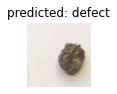

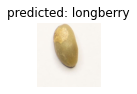

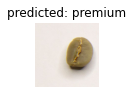

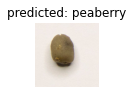

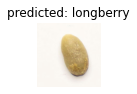

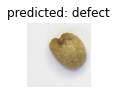

In [ ]:
visualize_model(model_tl)

## **memprediksi dari data uji**

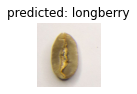

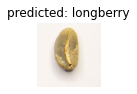

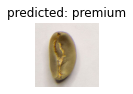

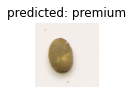

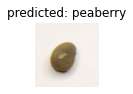

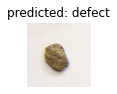

In [ ]:
# Visualizing the model predictions

def visualize_model(model, num_images=6):
    was_training = model.training
    model.eval()
    images_so_far = 0
    fig = plt.figure()

    with torch.no_grad():
        for i, (inputs, labels) in enumerate(dataloaders['test']):
            inputs = inputs.to(device)
            labels = labels.to(device)

            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)

            for j in range(inputs.size()[0]):
                images_so_far += 1
                ax = plt.subplot(num_images//2, 2, images_so_far)
                ax.axis('off')
                ax.set_title('predicted: {}'.format(class_names[preds[j]]))
                imshow(inputs.cpu().data[j])

                if images_so_far == num_images:
                    model.train(mode=was_training)
                    return
        model.train(mode=was_training)

visualize_model(model_tl)

## **memuat akurasi dari data uji**

In [ ]:
 def computeTestSetAccuracy(model, criterion):
    '''
    Function to compute the accuracy on the test set
    Parameters
        :param model: Model to test
        :param loss_criterion: Loss Criterion to minimize
    '''

    device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

    test_acc = 0.0
    test_loss = 0.0

    # Validation - No gradient tracking needed
    with torch.no_grad():

        # Set to evaluation mode
        model.eval()

        # Validation loop
        for j, (inputs, labels) in enumerate((dataloaders['test'])):
            inputs = inputs.to(device)
            labels = labels.to(device)

            # Forward pass - compute outputs on input data using the model
            outputs = model(inputs)

            # Compute loss
            loss = criterion(outputs, labels)

            # Compute the total loss for the batch and add it to valid_loss
            test_loss += loss.item() * inputs.size(0)

            # Calculate validation accuracy
            ret, predictions = torch.max(outputs.data, 1)
            correct_counts = predictions.eq(labels.data.view_as(predictions))

            # Convert correct_counts to float and then compute the mean
            acc = torch.mean(correct_counts.type(torch.FloatTensor))

            # Compute total accuracy in the whole batch and add to valid_acc
            test_acc += acc.item() * inputs.size(0)

            print("Test Batch number: {:03d}, Test: Loss: {:.4f}, Accuracy: {:.4f}".format(j, loss.item(), acc.item()))

    # Find average test loss and test accuracy
    avg_test_loss = test_loss/(dataset_sizes['test'])
    avg_test_acc = test_acc/(dataset_sizes['test'])

    print("\nTest accuracy : " + str(avg_test_acc))

In [ ]:
computeTestSetAccuracy(model_tl, criterion)

Test Batch number: 000, Test: Loss: 1.0735, Accuracy: 0.7500
Test Batch number: 001, Test: Loss: 0.3279, Accuracy: 1.0000
Test Batch number: 002, Test: Loss: 0.0778, Accuracy: 1.0000
Test Batch number: 003, Test: Loss: 0.5902, Accuracy: 0.7500
Test Batch number: 004, Test: Loss: 0.1349, Accuracy: 1.0000
Test Batch number: 005, Test: Loss: 0.9672, Accuracy: 0.7500
Test Batch number: 006, Test: Loss: 0.2676, Accuracy: 0.7500
Test Batch number: 007, Test: Loss: 1.4592, Accuracy: 0.5000
Test Batch number: 008, Test: Loss: 1.1779, Accuracy: 0.7500
Test Batch number: 009, Test: Loss: 0.6425, Accuracy: 0.5000
Test Batch number: 010, Test: Loss: 0.1255, Accuracy: 1.0000
Test Batch number: 011, Test: Loss: 0.0773, Accuracy: 1.0000
Test Batch number: 012, Test: Loss: 0.2322, Accuracy: 0.7500
Test Batch number: 013, Test: Loss: 0.1019, Accuracy: 1.0000
Test Batch number: 014, Test: Loss: 0.3663, Accuracy: 0.7500
Test Batch number: 015, Test: Loss: 0.2997, Accuracy: 0.7500
Test Batch number: 016, 

## **melakukan uji deteksi pada data uji**

### Defect

Actual       : Defect
Prediction 1 : longberry , Score: 38.4232%
Prediction 2 : premium , Score: 28.8908%
Prediction 3 : defect , Score: 26.9093%
Prediction 4 : peaberry , Score: 5.7767%


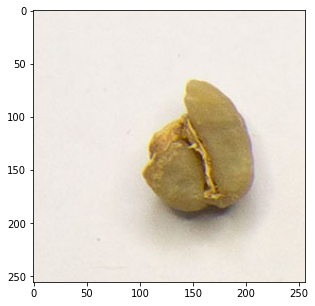

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1615.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 84.9822%
Prediction 2 : longberry , Score: 11.3289%
Prediction 3 : premium , Score: 2.6402%
Prediction 4 : peaberry , Score: 1.0487%


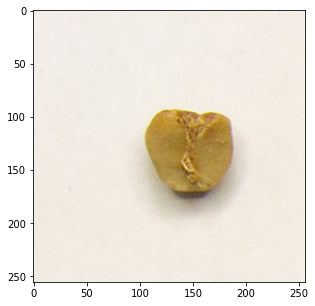

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1616.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 89.3749%
Prediction 2 : premium , Score: 9.0075%
Prediction 3 : longberry , Score: 1.1320%
Prediction 4 : peaberry , Score: 0.4856%


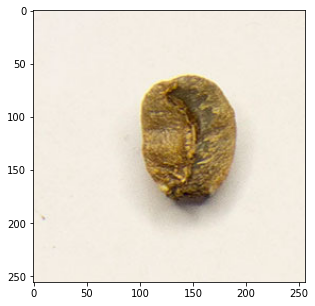

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1617.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 98.8245%
Prediction 2 : premium , Score: 1.1486%
Prediction 3 : longberry , Score: 0.0233%
Prediction 4 : peaberry , Score: 0.0037%


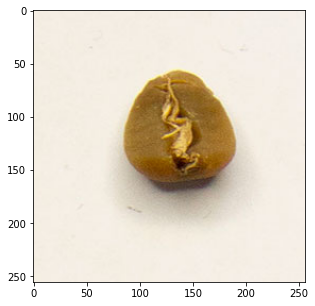

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1618.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 93.5937%
Prediction 2 : premium , Score: 5.1214%
Prediction 3 : peaberry , Score: 1.2068%
Prediction 4 : longberry , Score: 0.0781%


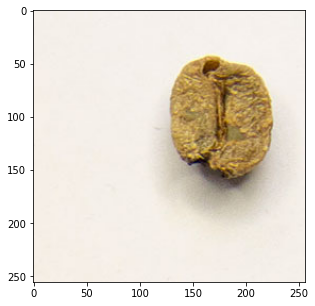

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1619.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : longberry , Score: 96.2389%
Prediction 2 : defect , Score: 2.9171%
Prediction 3 : premium , Score: 0.6705%
Prediction 4 : peaberry , Score: 0.1735%


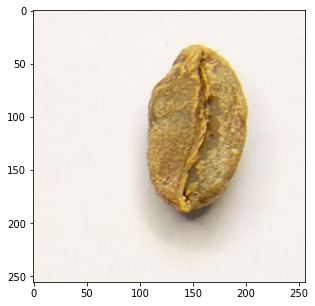

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1620.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : premium , Score: 60.0643%
Prediction 2 : defect , Score: 31.8221%
Prediction 3 : longberry , Score: 5.7610%
Prediction 4 : peaberry , Score: 2.3526%


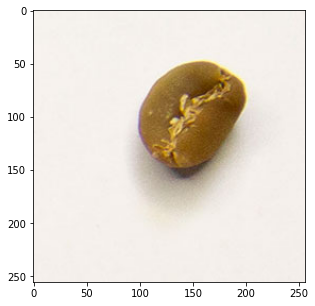

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1621.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 97.0023%
Prediction 2 : premium , Score: 2.7457%
Prediction 3 : peaberry , Score: 0.1917%
Prediction 4 : longberry , Score: 0.0603%


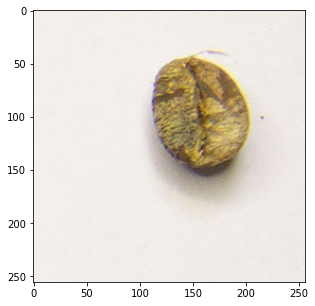

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1622.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 99.8079%
Prediction 2 : premium , Score: 0.1438%
Prediction 3 : peaberry , Score: 0.0453%
Prediction 4 : longberry , Score: 0.0030%


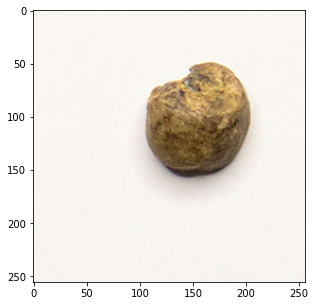

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1623.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 41.4788%
Prediction 2 : peaberry , Score: 39.0647%
Prediction 3 : longberry , Score: 12.0016%
Prediction 4 : premium , Score: 7.4549%


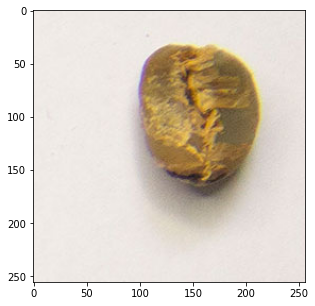

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1624.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 72.7168%
Prediction 2 : peaberry , Score: 26.3634%
Prediction 3 : premium , Score: 0.7742%
Prediction 4 : longberry , Score: 0.1455%


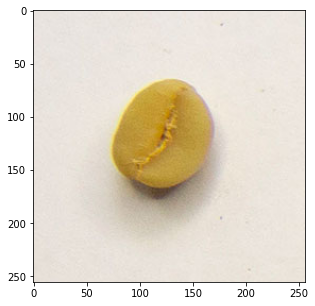

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1625.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 99.3468%
Prediction 2 : peaberry , Score: 0.3617%
Prediction 3 : premium , Score: 0.2732%
Prediction 4 : longberry , Score: 0.0183%


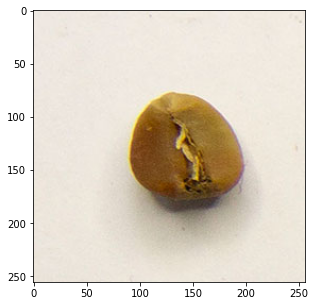

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1626.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 94.2599%
Prediction 2 : premium , Score: 5.1466%
Prediction 3 : peaberry , Score: 0.4927%
Prediction 4 : longberry , Score: 0.1008%


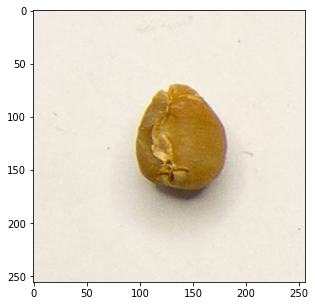

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1627.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 99.6345%
Prediction 2 : premium , Score: 0.2653%
Prediction 3 : peaberry , Score: 0.1002%
Prediction 4 : longberry , Score: 0.0001%


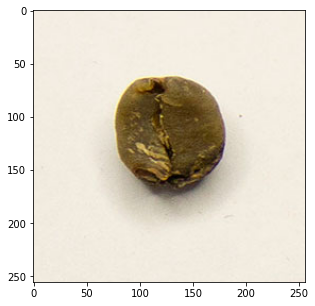

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1628.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 92.2945%
Prediction 2 : premium , Score: 5.6210%
Prediction 3 : peaberry , Score: 1.9935%
Prediction 4 : longberry , Score: 0.0910%


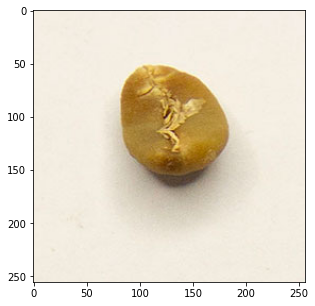

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1629.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : peaberry , Score: 73.9187%
Prediction 2 : defect , Score: 23.7677%
Prediction 3 : premium , Score: 1.3520%
Prediction 4 : longberry , Score: 0.9616%


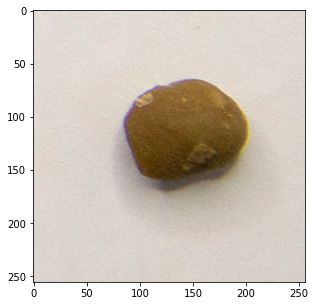

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1999.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 71.3621%
Prediction 2 : longberry , Score: 16.4407%
Prediction 3 : peaberry , Score: 10.7892%
Prediction 4 : premium , Score: 1.4080%


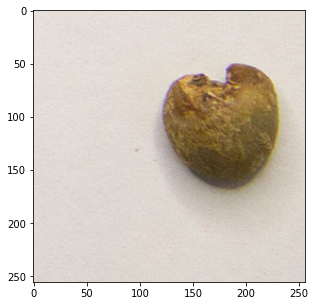

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1998.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : premium , Score: 50.7652%
Prediction 2 : longberry , Score: 32.2098%
Prediction 3 : peaberry , Score: 16.7873%
Prediction 4 : defect , Score: 0.2377%


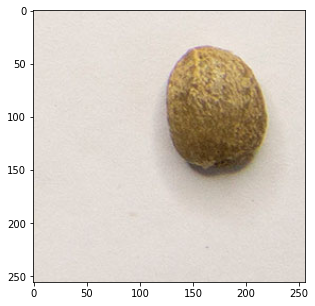

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1997.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 86.2013%
Prediction 2 : longberry , Score: 13.7346%
Prediction 3 : peaberry , Score: 0.0387%
Prediction 4 : premium , Score: 0.0254%


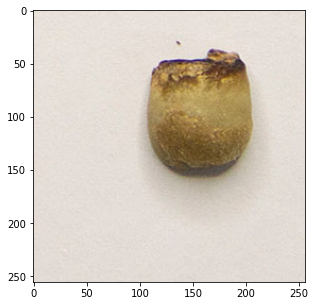

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1996.jpg'
print('Actual       : Defect')
predict(model_tl, test)

Actual       : Defect
Prediction 1 : defect , Score: 98.0471%
Prediction 2 : peaberry , Score: 1.6950%
Prediction 3 : longberry , Score: 0.1977%
Prediction 4 : premium , Score: 0.0602%


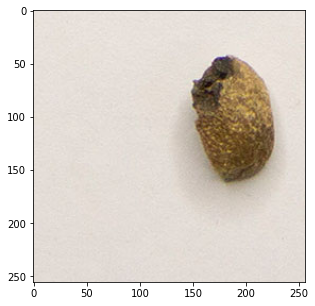

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/defect/1995.jpg'
print('Actual       : Defect')
predict(model_tl, test)

### Longberry

Actual       : Longberry
Prediction 1 : longberry , Score: 97.3693%
Prediction 2 : peaberry , Score: 2.2365%
Prediction 3 : premium , Score: 0.3323%
Prediction 4 : defect , Score: 0.0619%


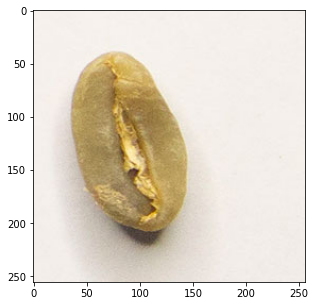

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1615.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 95.2574%
Prediction 2 : premium , Score: 4.5967%
Prediction 3 : peaberry , Score: 0.0857%
Prediction 4 : defect , Score: 0.0601%


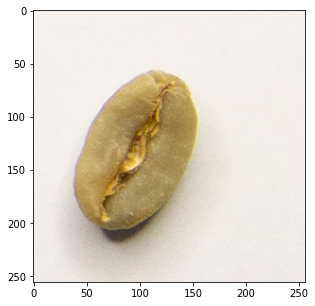

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1616.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 84.0618%
Prediction 2 : defect , Score: 8.0097%
Prediction 3 : premium , Score: 7.8887%
Prediction 4 : peaberry , Score: 0.0398%


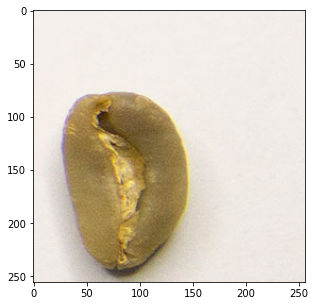

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1617.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 97.4754%
Prediction 2 : premium , Score: 1.9585%
Prediction 3 : defect , Score: 0.5596%
Prediction 4 : peaberry , Score: 0.0064%


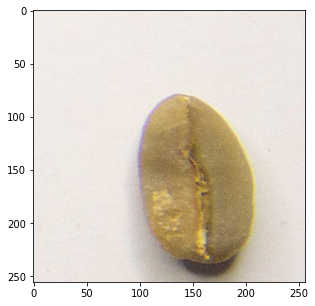

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1618.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 97.9920%
Prediction 2 : peaberry , Score: 1.1045%
Prediction 3 : premium , Score: 0.8686%
Prediction 4 : defect , Score: 0.0349%


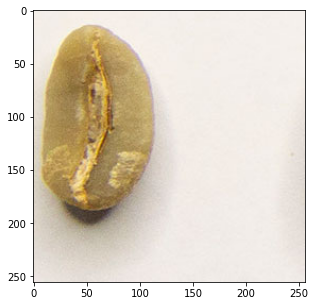

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1619.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.8336%
Prediction 2 : premium , Score: 0.1029%
Prediction 3 : peaberry , Score: 0.0586%
Prediction 4 : defect , Score: 0.0049%


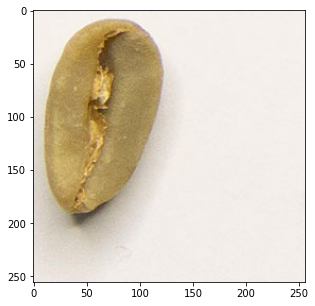

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1620.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 84.9082%
Prediction 2 : premium , Score: 14.6209%
Prediction 3 : peaberry , Score: 0.4135%
Prediction 4 : defect , Score: 0.0574%


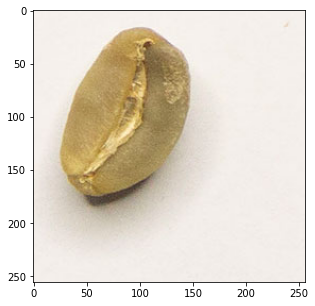

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1621.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.5087%
Prediction 2 : defect , Score: 0.4038%
Prediction 3 : premium , Score: 0.0523%
Prediction 4 : peaberry , Score: 0.0352%


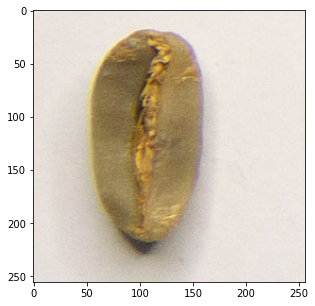

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1622.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.3662%
Prediction 2 : peaberry , Score: 0.5576%
Prediction 3 : premium , Score: 0.0695%
Prediction 4 : defect , Score: 0.0066%


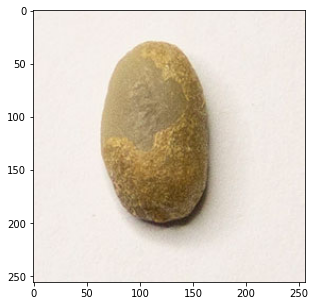

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1623.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.5329%
Prediction 2 : defect , Score: 0.3332%
Prediction 3 : premium , Score: 0.1310%
Prediction 4 : peaberry , Score: 0.0029%


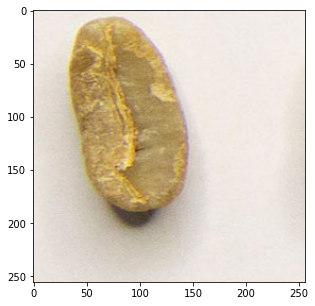

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1624.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 99.2184%
Prediction 2 : peaberry , Score: 0.4436%
Prediction 3 : premium , Score: 0.2888%
Prediction 4 : defect , Score: 0.0492%


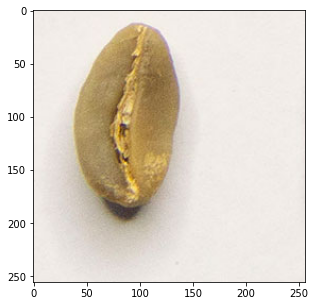

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1625.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : peaberry , Score: 96.6617%
Prediction 2 : longberry , Score: 2.6908%
Prediction 3 : premium , Score: 0.3797%
Prediction 4 : defect , Score: 0.2678%


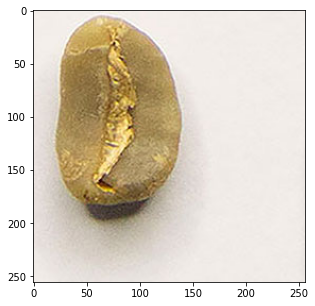

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1626.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 94.6468%
Prediction 2 : peaberry , Score: 3.3607%
Prediction 3 : premium , Score: 1.9765%
Prediction 4 : defect , Score: 0.0159%


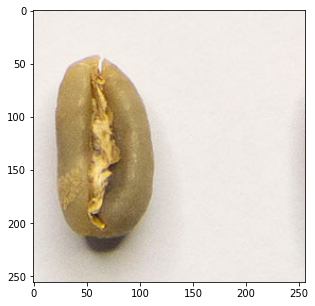

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1627.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 97.6520%
Prediction 2 : peaberry , Score: 1.9363%
Prediction 3 : defect , Score: 0.2320%
Prediction 4 : premium , Score: 0.1797%


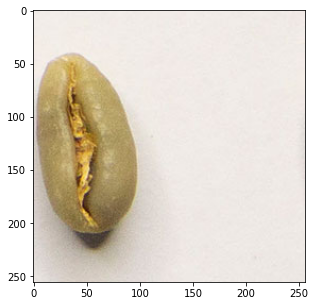

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1628.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 91.1730%
Prediction 2 : premium , Score: 8.1868%
Prediction 3 : defect , Score: 0.4182%
Prediction 4 : peaberry , Score: 0.2220%


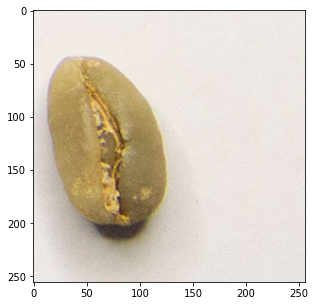

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1629.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : defect , Score: 44.5705%
Prediction 2 : longberry , Score: 38.0272%
Prediction 3 : peaberry , Score: 13.1040%
Prediction 4 : premium , Score: 4.2983%


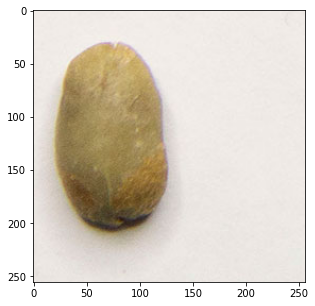

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1999.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 97.8714%
Prediction 2 : peaberry , Score: 2.0523%
Prediction 3 : premium , Score: 0.0758%
Prediction 4 : defect , Score: 0.0006%


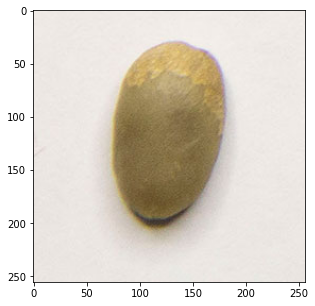

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1998.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 88.8267%
Prediction 2 : premium , Score: 8.2020%
Prediction 3 : defect , Score: 2.5745%
Prediction 4 : peaberry , Score: 0.3968%


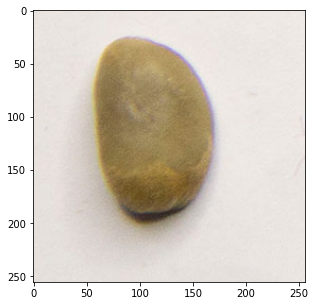

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1997.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : longberry , Score: 91.9948%
Prediction 2 : defect , Score: 6.8235%
Prediction 3 : premium , Score: 1.1635%
Prediction 4 : peaberry , Score: 0.0181%


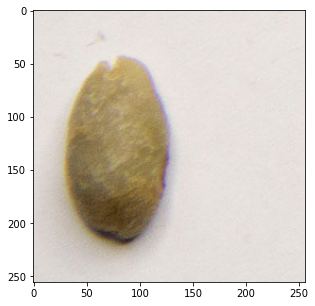

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1996.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

Actual       : Longberry
Prediction 1 : premium , Score: 91.7294%
Prediction 2 : longberry , Score: 4.2390%
Prediction 3 : defect , Score: 3.6871%
Prediction 4 : peaberry , Score: 0.3445%


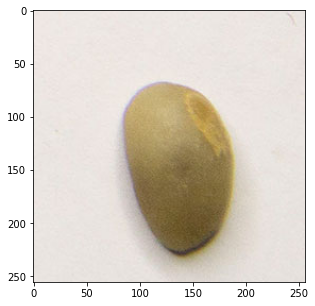

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/longberry/1995.jpg'
print('Actual       : Longberry')
predict(model_tl, test)

### Peaberry

Actual       : Peaberry
Prediction 1 : peaberry , Score: 81.8814%
Prediction 2 : premium , Score: 13.6395%
Prediction 3 : defect , Score: 4.4476%
Prediction 4 : longberry , Score: 0.0316%


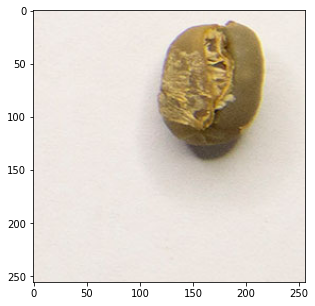

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1615.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 98.1145%
Prediction 2 : longberry , Score: 0.8199%
Prediction 3 : premium , Score: 0.7483%
Prediction 4 : defect , Score: 0.3174%


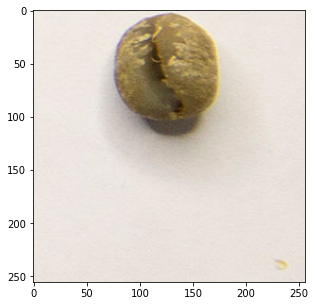

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1616.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 94.7348%
Prediction 2 : defect , Score: 5.1301%
Prediction 3 : premium , Score: 0.0893%
Prediction 4 : longberry , Score: 0.0458%


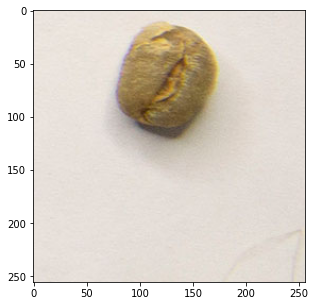

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1617.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 94.3972%
Prediction 2 : premium , Score: 4.2865%
Prediction 3 : defect , Score: 1.2377%
Prediction 4 : longberry , Score: 0.0787%


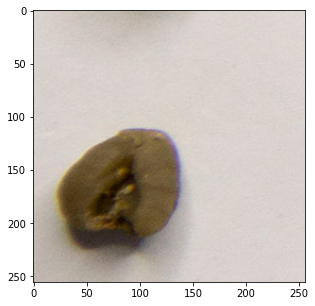

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1618.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 72.8978%
Prediction 2 : defect , Score: 26.8950%
Prediction 3 : premium , Score: 0.2004%
Prediction 4 : longberry , Score: 0.0068%


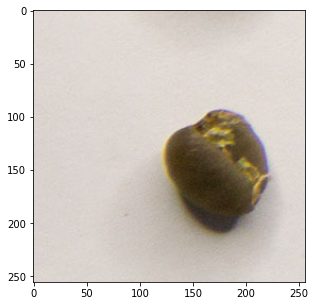

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1619.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 99.7641%
Prediction 2 : premium , Score: 0.1557%
Prediction 3 : longberry , Score: 0.0537%
Prediction 4 : defect , Score: 0.0265%


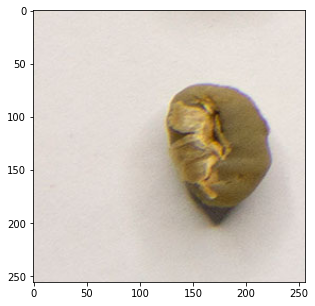

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1620.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 94.9318%
Prediction 2 : premium , Score: 2.3817%
Prediction 3 : longberry , Score: 2.2552%
Prediction 4 : defect , Score: 0.4313%


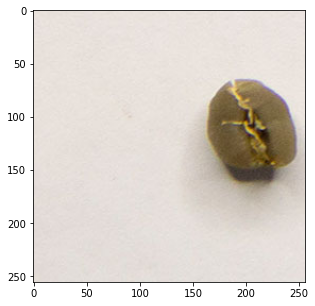

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1621.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 65.6803%
Prediction 2 : premium , Score: 31.8024%
Prediction 3 : longberry , Score: 2.3998%
Prediction 4 : defect , Score: 0.1175%


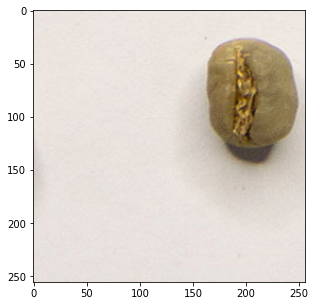

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1622.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : defect , Score: 60.6213%
Prediction 2 : peaberry , Score: 19.8551%
Prediction 3 : premium , Score: 19.5188%
Prediction 4 : longberry , Score: 0.0049%


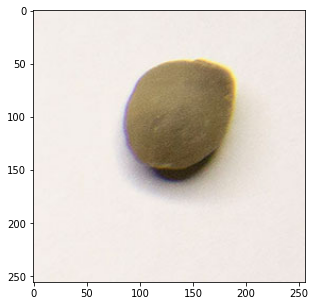

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1623.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 85.0419%
Prediction 2 : premium , Score: 14.1235%
Prediction 3 : defect , Score: 0.6217%
Prediction 4 : longberry , Score: 0.2129%


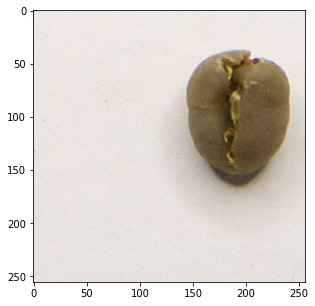

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1624.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 87.6657%
Prediction 2 : premium , Score: 8.0303%
Prediction 3 : defect , Score: 3.2240%
Prediction 4 : longberry , Score: 1.0799%


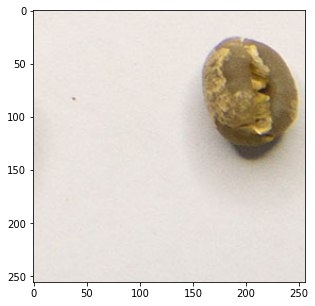

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1625.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 98.8693%
Prediction 2 : premium , Score: 0.9261%
Prediction 3 : defect , Score: 0.2030%
Prediction 4 : longberry , Score: 0.0016%


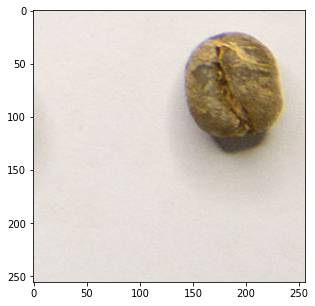

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1626.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 86.5139%
Prediction 2 : premium , Score: 11.6540%
Prediction 3 : defect , Score: 1.8302%
Prediction 4 : longberry , Score: 0.0020%


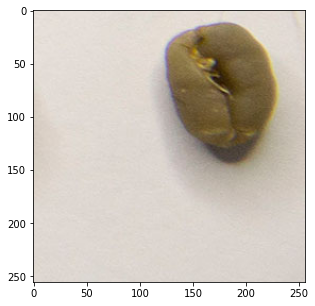

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1627.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : premium , Score: 39.9245%
Prediction 2 : defect , Score: 38.3132%
Prediction 3 : peaberry , Score: 19.9974%
Prediction 4 : longberry , Score: 1.7649%


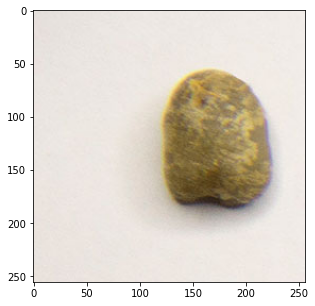

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1628.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 74.1863%
Prediction 2 : premium , Score: 17.2091%
Prediction 3 : defect , Score: 8.2703%
Prediction 4 : longberry , Score: 0.3343%


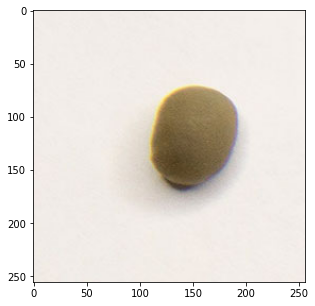

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1629.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 75.0258%
Prediction 2 : premium , Score: 18.2335%
Prediction 3 : longberry , Score: 5.5700%
Prediction 4 : defect , Score: 1.1707%


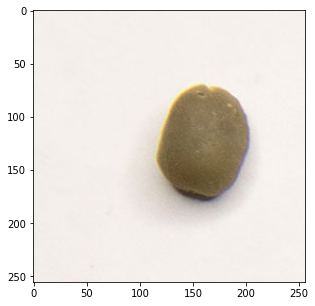

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1630.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 98.7337%
Prediction 2 : premium , Score: 1.1616%
Prediction 3 : defect , Score: 0.0565%
Prediction 4 : longberry , Score: 0.0482%


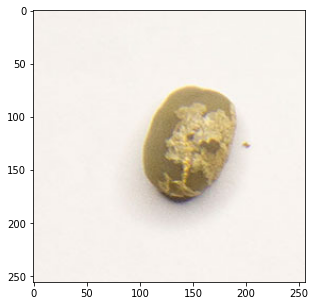

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1631.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : premium , Score: 53.1345%
Prediction 2 : peaberry , Score: 46.3155%
Prediction 3 : defect , Score: 0.4663%
Prediction 4 : longberry , Score: 0.0838%


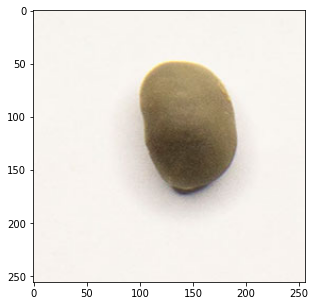

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1632.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : premium , Score: 80.3185%
Prediction 2 : peaberry , Score: 14.8548%
Prediction 3 : longberry , Score: 4.6645%
Prediction 4 : defect , Score: 0.1622%


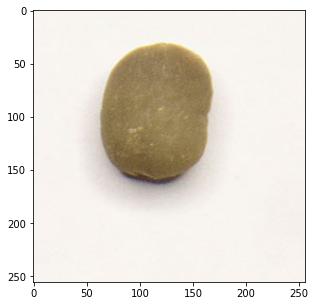

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1633.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 93.6670%
Prediction 2 : defect , Score: 5.1298%
Prediction 3 : premium , Score: 0.9062%
Prediction 4 : longberry , Score: 0.2970%


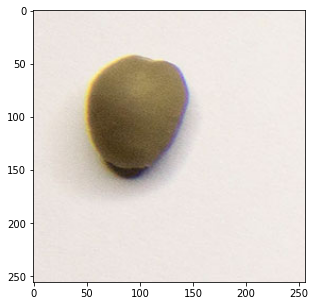

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1634.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 82.0214%
Prediction 2 : premium , Score: 9.0144%
Prediction 3 : defect , Score: 8.9022%
Prediction 4 : longberry , Score: 0.0619%


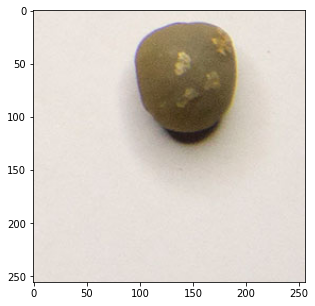

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1999.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 91.3602%
Prediction 2 : premium , Score: 8.3015%
Prediction 3 : defect , Score: 0.2720%
Prediction 4 : longberry , Score: 0.0663%


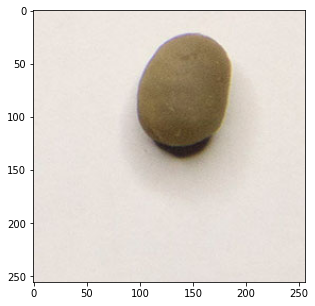

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1998.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 73.8616%
Prediction 2 : premium , Score: 25.4152%
Prediction 3 : longberry , Score: 0.3757%
Prediction 4 : defect , Score: 0.3475%


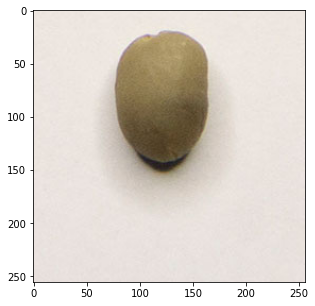

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1997.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

Actual       : Peaberry
Prediction 1 : peaberry , Score: 92.3034%
Prediction 2 : defect , Score: 6.6476%
Prediction 3 : longberry , Score: 0.6316%
Prediction 4 : premium , Score: 0.4174%


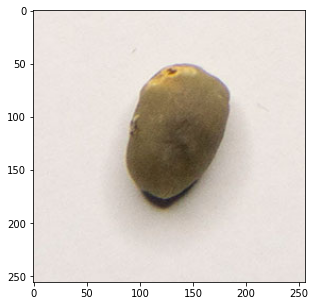

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/peaberry/1996.jpg'
print("Actual       : Peaberry")
predict(model_tl, test)

### Premium

Actual       : Premium
Prediction 1 : premium , Score: 99.2397%
Prediction 2 : peaberry , Score: 0.4792%
Prediction 3 : defect , Score: 0.1961%
Prediction 4 : longberry , Score: 0.0851%


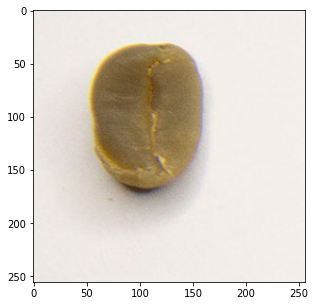

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1614.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : longberry , Score: 80.6987%
Prediction 2 : peaberry , Score: 14.7058%
Prediction 3 : premium , Score: 4.5398%
Prediction 4 : defect , Score: 0.0557%


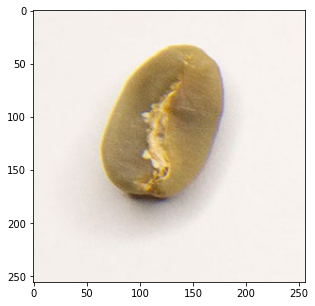

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1615.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 74.2078%
Prediction 2 : longberry , Score: 22.3025%
Prediction 3 : defect , Score: 3.4569%
Prediction 4 : peaberry , Score: 0.0327%


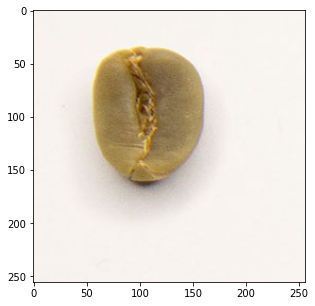

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1616.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : longberry , Score: 59.6853%
Prediction 2 : premium , Score: 18.2426%
Prediction 3 : defect , Score: 17.8329%
Prediction 4 : peaberry , Score: 4.2392%


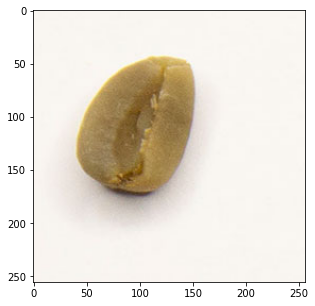

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1617.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 88.0023%
Prediction 2 : defect , Score: 7.4432%
Prediction 3 : peaberry , Score: 3.4254%
Prediction 4 : longberry , Score: 1.1291%


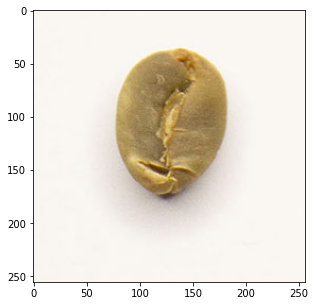

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1618.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : defect , Score: 93.8468%
Prediction 2 : peaberry , Score: 3.1566%
Prediction 3 : premium , Score: 2.9663%
Prediction 4 : longberry , Score: 0.0303%


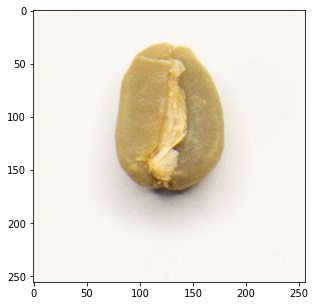

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1619.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 91.4927%
Prediction 2 : defect , Score: 4.6342%
Prediction 3 : longberry , Score: 2.1702%
Prediction 4 : peaberry , Score: 1.7030%


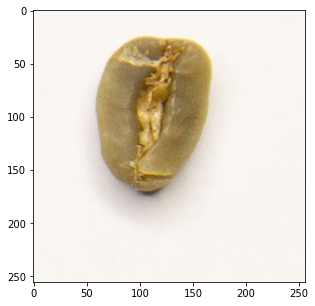

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1620.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 95.1091%
Prediction 2 : longberry , Score: 3.2299%
Prediction 3 : peaberry , Score: 1.5616%
Prediction 4 : defect , Score: 0.0994%


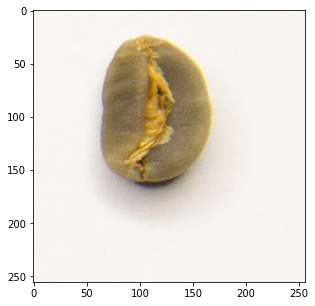

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1621.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 97.8159%
Prediction 2 : longberry , Score: 1.2928%
Prediction 3 : defect , Score: 0.5058%
Prediction 4 : peaberry , Score: 0.3855%


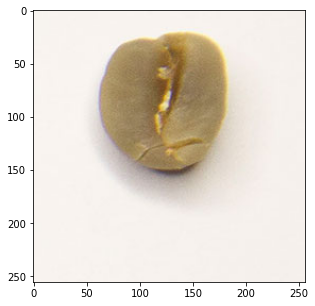

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1622.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : longberry , Score: 77.7354%
Prediction 2 : premium , Score: 12.7646%
Prediction 3 : peaberry , Score: 5.7373%
Prediction 4 : defect , Score: 3.7627%


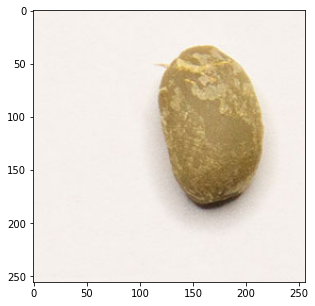

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1623.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : longberry , Score: 42.1457%
Prediction 2 : premium , Score: 30.7688%
Prediction 3 : peaberry , Score: 25.4728%
Prediction 4 : defect , Score: 1.6126%


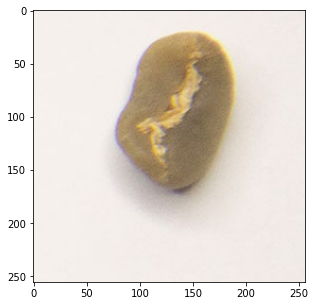

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1624.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 59.3196%
Prediction 2 : defect , Score: 21.5787%
Prediction 3 : peaberry , Score: 16.2961%
Prediction 4 : longberry , Score: 2.8056%


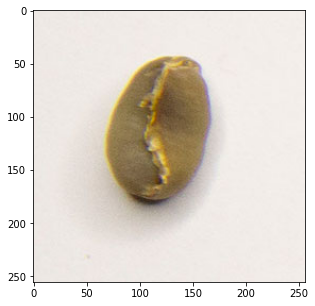

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1625.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : longberry , Score: 86.7720%
Prediction 2 : premium , Score: 12.8346%
Prediction 3 : defect , Score: 0.2895%
Prediction 4 : peaberry , Score: 0.1039%


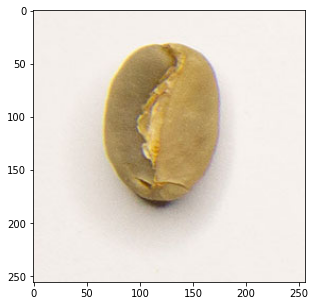

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1626.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 96.4308%
Prediction 2 : longberry , Score: 2.9178%
Prediction 3 : defect , Score: 0.5004%
Prediction 4 : peaberry , Score: 0.1510%


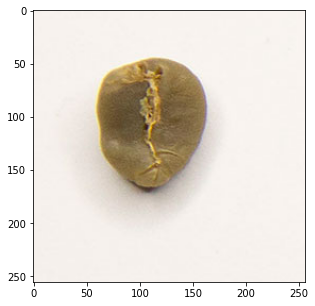

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1627.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 68.9221%
Prediction 2 : longberry , Score: 29.1948%
Prediction 3 : peaberry , Score: 1.8268%
Prediction 4 : defect , Score: 0.0562%


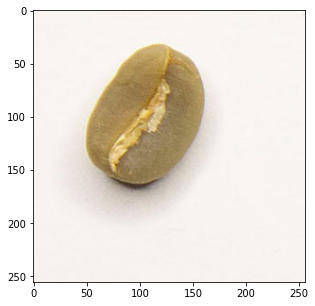

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1628.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 92.4207%
Prediction 2 : defect , Score: 6.5212%
Prediction 3 : longberry , Score: 0.9601%
Prediction 4 : peaberry , Score: 0.0980%


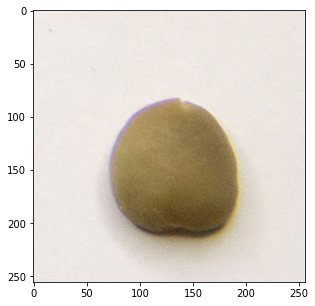

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1999.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 98.7685%
Prediction 2 : peaberry , Score: 1.0149%
Prediction 3 : defect , Score: 0.1149%
Prediction 4 : longberry , Score: 0.1017%


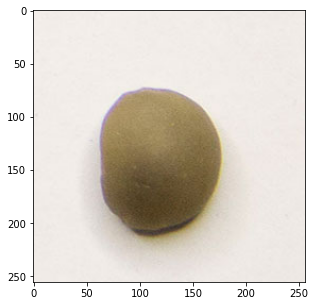

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1998.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 94.9794%
Prediction 2 : longberry , Score: 3.1991%
Prediction 3 : peaberry , Score: 0.9922%
Prediction 4 : defect , Score: 0.8294%


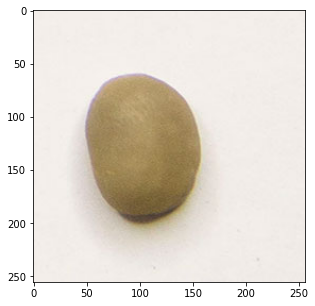

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1997.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 98.6258%
Prediction 2 : defect , Score: 1.0039%
Prediction 3 : longberry , Score: 0.3622%
Prediction 4 : peaberry , Score: 0.0082%


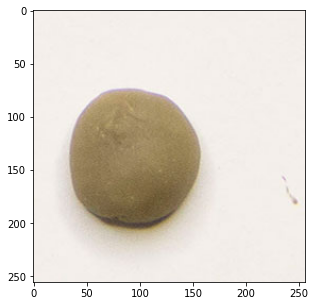

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1996.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 88.6286%
Prediction 2 : longberry , Score: 6.7239%
Prediction 3 : defect , Score: 3.3467%
Prediction 4 : peaberry , Score: 1.3008%


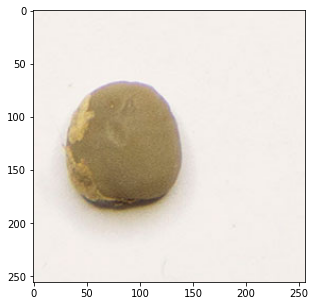

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1995.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 96.8492%
Prediction 2 : defect , Score: 1.8729%
Prediction 3 : peaberry , Score: 0.7523%
Prediction 4 : longberry , Score: 0.5255%


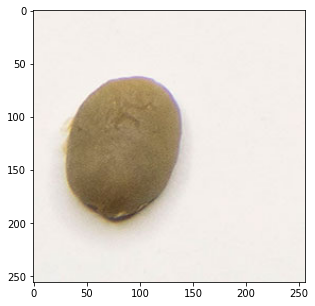

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1994.jpg'
print('Actual       : Premium')
predict(model_tl, test)

Actual       : Premium
Prediction 1 : premium , Score: 70.4381%
Prediction 2 : defect , Score: 28.3215%
Prediction 3 : longberry , Score: 1.0526%
Prediction 4 : peaberry , Score: 0.1878%


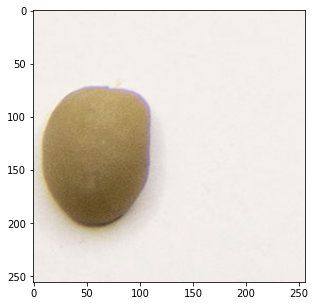

In [ ]:
test = '/content/drive/MyDrive/CFStar-Tech-800-2021/test/premium/1993.jpg'
print('Actual       : Premium')
predict(model_tl, test)

## **mengevaluasi model**

In [ ]:
nb_classes = 4

confusion_matrix = torch.zeros(nb_classes, nb_classes)
with torch.no_grad():
    for i, (inputs, classes) in enumerate(dataloaders['test']):
        inputs = inputs.to(device)
        classes = classes.to(device)
        outputs = model_tl(inputs)
        _, preds = torch.max(outputs, 1)
        for t, p in zip(classes.view(-1), preds.view(-1)):
                confusion_matrix[t.long(), p.long()] += 1

print(confusion_matrix)

tensor([[297.,  39.,  36.,  28.],
        [  8., 364.,  12.,  16.],
        [ 14.,   7., 311.,  68.],
        [ 46.,  25.,  25., 304.]])


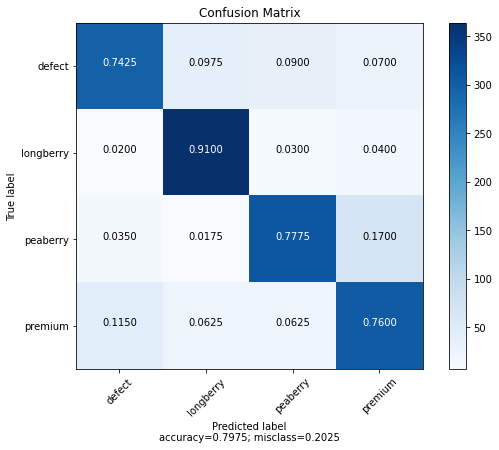

In [ ]:
plot_confusion_matrix(cm           = np.array([[297.,  39.,  36.,  28.],
                                               [  8., 364.,  12.,  16.],
                                               [ 14.,   7., 311.,  68.],
                                               [ 46.,  25.,  25., 304.]]),
                      normalize    = True,
                      target_names = ['defect', 'longberry', 'peaberry', 'premium'],
                      title        = "Confusion Matrix")

In [ ]:
#To get the per-class accuracy:

print(confusion_matrix.diag()/confusion_matrix.sum(1))

tensor([0.7425, 0.9100, 0.7775, 0.7600])
